In [2]:
import anndata as ad
import scanpy as sc

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

from scipy import stats
import os

%matplotlib inline

from SC2Spa import Vis

/mnt/win1
/mnt/win1/SC2Spa_Notebook/SVA_BM


In [3]:
def rename(df):
    t = df.columns.tolist()
    t[0] = 'g'
    df.columns = t
    return df

def pp(adata):
    
    adata.var_names_make_unique()
    
    sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)
    adata.var['n_cells_by_counts_norm'] = adata.var['n_cells_by_counts'] / adata.shape[0]
    adata.var['g'] = adata.var.index.tolist()
    
    adata.raw = adata
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    
def integrate(adata, SpatialDE_path, MI_path, LPG_path, 
              t_column = ['g', 'imp_sumup_norm', 'I', 'LLR']):
    
    SpatialDE = pd.read_csv(SpatialDE_path)[['g', 'LLR', 'pval', 'qval']].drop_duplicates()
    MoransI = rename(pd.read_csv(MI_path))
    LPG = rename(pd.read_csv(LPG_path))
    
    SVA = LPG.merge(MoransI, how='left').merge(SpatialDE,
                    how = 'left')[t_column].merge(adata.var[['g', 'n_cells_by_counts_norm']], how = 'left')
    
    SVA['LLR'] = SVA['LLR'].apply(lambda x: 0 if x==np.inf else x)
    
    return SVA

In [4]:
adata_HC1 = ad.read_h5ad('../Dataset/AdataMH1.h5ad')
adata_HC2 = ad.read_h5ad('../Dataset/AdataMH2.h5ad')
adata_Em1 = ad.read_h5ad('../Dataset/AdataEmbryo1.h5ad')

ST = pd.read_csv('../MOB_Visium/MOBRep12_Processed.csv')
loc = pd.read_csv('../MOB_Visium/MOBRep12_loc.csv')[['x', 'y']]
adata_MOB = ad.AnnData(X=ST.values, obs = loc, var = pd.DataFrame(ST.columns).set_index(0))
adata_MOB.var.index.name = None

pp(adata_HC1)
pp(adata_HC2)
pp(adata_Em1)
pp(adata_MOB)

#HC1
Anno = pd.read_csv('../MouseHippocampus_SSV2/ssHippo_RCTD.csv', index_col = 0)
Anno['MCT'] = 't'

index1 = Anno.index[(Anno['celltype_1'] == Anno['celltype_2'])]
Anno['MCT'][index1] = Anno['celltype_1'][index1]
index2 = Anno.index[(Anno['celltype_1'] != Anno['celltype_2'])]
Anno['MCT'][index2] = (Anno['celltype_1'][index2] + '_' + Anno['celltype_2'][index2]).apply(lambda x: '_'.join(sorted(set(x.split('_')))))

adata_HC1.obs = adata_HC1.obs.merge(Anno, left_index = True, right_index = True, how = 'left')
adata_HC1_selected = adata_HC1[adata_HC1.obs['spot_class'].apply(lambda x: x in ['doublet_certain', 'singlet'])]

#Em1
Anno = pd.read_csv('../MouseEmbryo_SSV2/slideSeq_Puck190926_03_RCTD.csv', index_col = 0)
Anno['MCT'] = 't'

index1 = Anno.index[(Anno['celltype_1'] == Anno['celltype_2'])]
Anno['MCT'][index1] = Anno['celltype_1'][index1]
index2 = Anno.index[(Anno['celltype_1'] != Anno['celltype_2'])]
Anno['MCT'][index2] = (Anno['celltype_1'][index2] + '_' + Anno['celltype_2'][index2]).apply(lambda x: '_'.join(sorted(set(x.split('_')))))

adata_Em1.obs = adata_Em1.obs.merge(Anno, left_index = True, right_index = True, how = 'left')
adata_Em1_selected = adata_Em1[adata_Em1.obs['spot_class'].apply(lambda x: x in ['doublet_certain', 'singlet'])]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/home/linbuliao/anaconda3/lib/python3.9/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [5]:
SVA_HC1 = integrate(adata_HC1, SpatialDE_path = 'SpaDE/SpatialDE_HC1.csv',
                    MI_path = 'MoransI/MI_HC1.csv',
                    LPG_path = '../MouseHippocampus_SSV2/GeneInfo/LPG_HC1.csv')
SVA_HC2 = integrate(adata_HC2, SpatialDE_path = 'SpaDE/SpatialDE_HC2.csv',
                    MI_path = 'MoransI/MI_HC2.csv',
                    LPG_path = '../MouseHippocampus_SSV2/GeneInfo/LPG_HC2.csv')
SVA_Em1 = integrate(adata_Em1, SpatialDE_path = 'SpaDE/SpatialDE_Em1.csv',
                    MI_path = 'MoransI/MI_Em1.csv',
                    LPG_path = '../MouseEmbryo_SSV2/GeneInfo/LPG_Em1.csv')
SVA_MOB = integrate(adata_MOB, SpatialDE_path = 'SpaDE/SpatialDE_MOB.csv',
                    MI_path = 'MoransI/MI_MOB.csv',
                    LPG_path = '../MOB_Visium/GeneInfo/LPG_MOB.csv')

In [6]:
SVA_HC1

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
0,0610009E02RIK,0.002271,-0.001566,591.250306,0.001754
1,0610009L18RIK,0.007220,0.001859,22.000086,0.008798
2,0610009O20RIK,0.008403,-0.003470,4.606811,0.017398
3,0610010F05RIK,0.072461,0.013905,24.394931,0.044329
4,0610010K14RIK,0.002194,-0.000292,0.516911,0.000339
...,...,...,...,...,...
20522,MT-TR,0.002878,-0.000818,700.548313,0.000877
20523,MT-TS2,0.011844,0.003570,1.697407,0.008062
20524,MT-TT,0.002283,-0.000835,0.423049,0.000934
20525,MT-TV,0.082886,0.009159,1.325774,0.018049


In [7]:
SDE_SC2Spa = []
SDE_MI = []
MI_SC2Spa = []

for SVA in [SVA_HC1, SVA_HC2, SVA_Em1, SVA_MOB]:

    select = ~(SVA['imp_sumup_norm'].isna() | SVA['LLR'].isna())
    t = stats.pearsonr(SVA['imp_sumup_norm'].values[select], SVA['LLR'].values[select])
    SDE_SC2Spa.append(t[0])
    
    select = ~(SVA['LLR'].isna() | SVA['I'].isna())
    t = stats.pearsonr(SVA['LLR'].values[select], SVA['I'].values[select])
    SDE_MI.append(t[0])
    
    select = ~(SVA['imp_sumup_norm'].isna() | SVA['I'].isna())
    t = stats.pearsonr(SVA['imp_sumup_norm'].values[select], SVA['I'].values[select])
    MI_SC2Spa.append(t[0])

In [8]:
SVA_R = pd.DataFrame([SDE_MI, MI_SC2Spa, SDE_SC2Spa],
                     columns = ['HC1', 'HC2', 'Embryo_LLR', 'MOB'],
                    index = ['SpatialDE_MoransI', 'SC2Spa_MoransI', 'SC2Spa_SpatialDE'])
SVA_R

,HC1,HC2,Embryo_LLR,MOB
SpatialDE_MoransI,0.502359,0.384472,0.013812,0.778111
SC2Spa_MoransI,0.561617,0.597355,0.552230,0.393400
SC2Spa_SpatialDE,0.176895,0.150155,-0.006770,0.407295


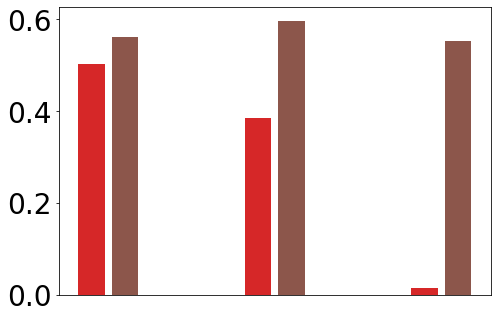

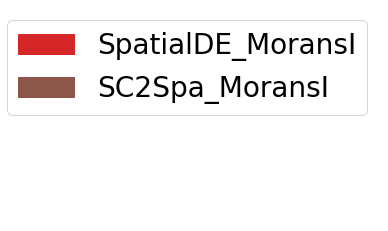

In [9]:
import matplotlib.pyplot as plt
import matplotlib as mpl

SVA_R_Select = SVA_R.iloc[:2, :3]
fontsize = 28

ind = np.arange(SVA_R_Select.shape[1])
colors = ['C3', 'C5', 'C4']
width = 0.2

plt.rcParams['font.size'] = fontsize

fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
for i in range(SVA_R_Select.shape[0]):
    ax.bar(ind + width * i, SVA_R_Select.iloc[i],
           fill = True, color = colors[i], width = width-0.04)

plt.tick_params(axis='x',
                which='both',
                bottom=False,
                labelbottom=False)

plt.savefig('PCC_no_legend.png', bbox_inches = 'tight')
plt.show()

###################
####Draw legend####
###################
palette = dict(zip(SVA_R_Select.index.tolist(), colors))
# Create legend handles manually
handles = [mpl.patches.Patch(color=palette[x], label = x) for x in palette.keys()]
# Create legend
plt.legend(handles=handles)
# Get current axes object and turn off axis
plt.gca().set_axis_off()
plt.savefig('Legend_PCC', bbox_inches='tight')

In [10]:
MI_SC2Spa

[0.5616173994415271,
 0.5973549038989299,
 0.5522295817162317,
 0.3933995501487094]

In [11]:
SVA_Em1

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
0,0610005C13RIK,0.008812,0.041008,602.829888,0.006569
1,0610007P14RIK,0.052852,0.002176,33.353940,0.037603
2,0610009B22RIK,0.030524,0.000535,2.318960,0.021060
3,0610009E02RIK,0.003782,-0.001478,1022.944059,0.001522
4,0610009L18RIK,0.004255,-0.000217,1.440301,0.003357
...,...,...,...,...,...
20215,MT-TP,0.002798,-0.000322,3.098359,0.000314
20216,MT-TQ,0.002659,-0.000123,3.930066,0.000121
20217,MT-TT,0.002848,-0.000374,607.044955,0.000386
20218,MT-TV,0.002556,-0.000260,1027.614007,0.000266


In [12]:
cmap = sns.cubehelix_palette(n_colors = 32,start = 2, rot=1.5, as_cmap = True)
s = 14

def Viz1(df, fontsize = 32, vmin= -0.05, vmax = 0.5, s = 14, save = None):
    
    plt.rcParams['font.size'] = fontsize
    plt.figure(figsize = (12, 8))
    plt.scatter(df['imp_sumup_norm'], df['LLR'], s = s, alpha = 0.7,
                c = df['I'], vmin = vmin, vmax = vmax, cmap = cmap)
    plt.xlabel('Contribution to Location Prediction')
    plt.ylabel('SpatialDE LLR')
    plt.colorbar()
    
    if(save != None):
        plt.savefig('Compare/' + save + '_Imp_LLR_I.png',
                    dpi = 128, bbox_inches='tight')
    
def Viz2(df, fontsize = 32, s = 14):

    plt.rcParams['font.size'] = fontsize
    plt.figure(figsize = (12, 8))
    plt.scatter(df['imp_sumup_norm'], df['I'], s = s, alpha = 0.7, c = df['LLR'], cmap = cmap)
    plt.xlabel('Contribution to Location Prediction')
    plt.ylabel('Moran\'s I')
    plt.colorbar()
    
def VizCus(df, x_name, x_label, y_name, y_label, root, c_name = None,
           fontsize = 32, vmin= -0.05, vmax = 0.5, s = 14, save = None):
    
    plt.rcParams['font.size'] = fontsize
    plt.figure(figsize = (12, 8))
    if(c_name == None):
        plt.scatter(df[x_name], df[y_name], s = s)
    elif(vmin!=None):
        plt.scatter(df[x_name], df[y_name], s = s, alpha = 0.7,
                c = df[c_name], vmin = vmin, vmax = vmax, cmap = cmap)
    else:
        plt.scatter(df[x_name], df[y_name], s = s, alpha = 0.7,
                c = df[c_name], cmap = cmap)
    plt.colorbar()
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    
    if(save != None):
        plt.savefig(root + save + '.png',
                    dpi = 128, bbox_inches='tight')

In [13]:
root = 'Compare/'
SVA_HC1.sort_values('imp_sumup_norm', ascending = False)[:100].to_csv(root + 'HC1_SC2Spa_top100.csv', index = None)
SVA_HC1.sort_values('I', ascending = False)[:100].to_csv(root + 'HC1_MI_top100.csv', index = None)
SVA_HC1.sort_values('LLR', ascending = False)[:100].to_csv(root + 'HC1_SpatialDE_top100.csv', index = None)

SVA_HC2.sort_values('imp_sumup_norm', ascending = False)[:100].to_csv(root + 'HC2_SC2Spa_top100.csv', index = None)
SVA_HC2.sort_values('I', ascending = False)[:100].to_csv(root + 'HC2_MI_top100.csv', index = None)
SVA_HC2.sort_values('LLR', ascending = False)[:100].to_csv(root + 'HC2_SpatialDE_top100.csv', index = None)

SVA_Em1.sort_values('imp_sumup_norm', ascending = False)[:100].to_csv(root + 'Em1_SC2Spa_top100.csv', index = None)
SVA_Em1.sort_values('I', ascending = False)[:100].to_csv(root + 'Em1_MI_top100.csv', index = None)
SVA_Em1.sort_values('LLR', ascending = False)[:100].to_csv(root + 'Em1_SpatialDE_top100.csv', index = None)

SVA_MOB.sort_values('imp_sumup_norm', ascending = False)[:100].to_csv(root + 'MOB_SC2Spa_top100.csv', index = None)
SVA_MOB.sort_values('I', ascending = False)[:100].to_csv(root + 'MOB_MI_top100.csv', index = None)
SVA_MOB.sort_values('LLR', ascending = False)[:100].to_csv(root + 'MOB_SpatialDE_top100.csv', index = None)

# HC1

In [14]:
root = 'Compare/HC1/'
if not os.path.exists(root):
    os.makedirs(root)

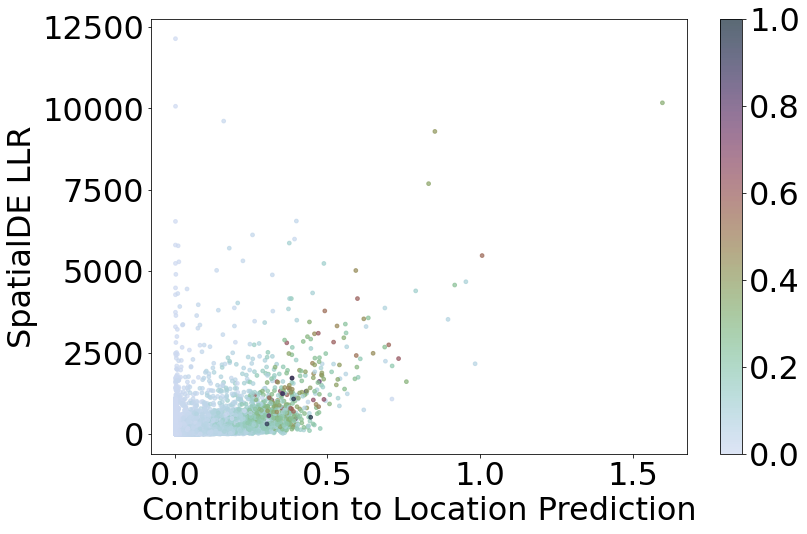

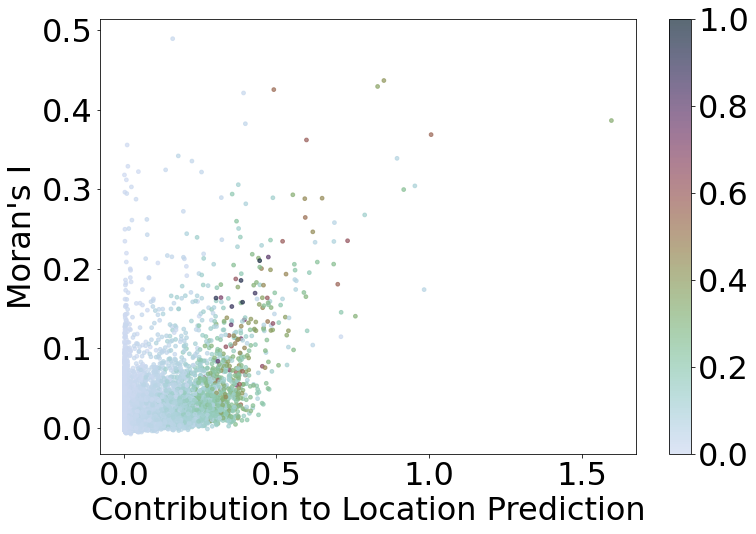

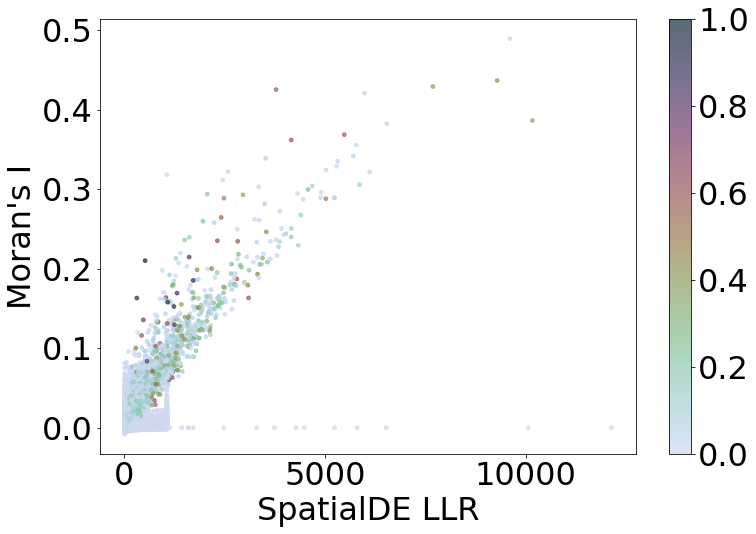

In [15]:
VizCus(SVA_HC1, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'LLR', y_label = 'SpatialDE LLR', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'HC1_imp_LLR_ncell.png')
VizCus(SVA_HC1, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'I', y_label = 'Moran\'s I', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'HC1_imp_I_ncell.png')
VizCus(SVA_HC1, x_name = 'LLR', x_label = 'SpatialDE LLR',
       y_name = 'I', y_label = 'Moran\'s I', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'HC1_LLR_I_ncell.png')

In [40]:
SVA_HC1[SVA_HC1['imp_sumup_norm'] < 0.1].sort_values('I', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
10672,KCNJ13,0.010619,0.355427,5780.496217,0.008487
6391,FOLR1,0.012959,0.328642,5288.999787,0.011344
9700,H2-AB1,0.047435,0.321913,2579.343489,0.002348
13889,PKLR,0.001770,0.317763,1058.534657,0.000085
9699,H2-AA,0.008023,0.311600,2451.781351,0.001867


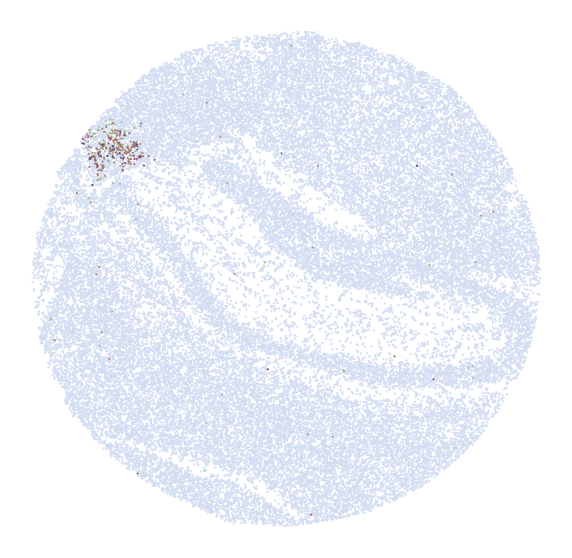

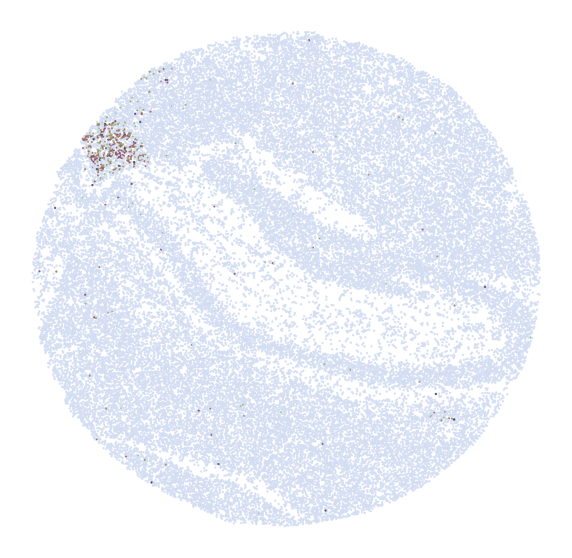

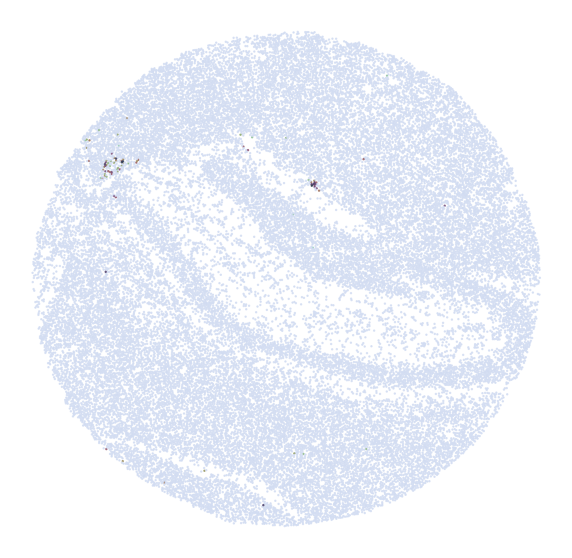

In [42]:
Vis.DrawGenes2(adata_HC1, 'KCNJ13', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, 'FOLR1', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, 'H2-AB1', FM = False, root = root, save = 'HC1')

In [14]:
SVA_HC1[SVA_HC1['I'] < 0.1].sort_values('imp_sumup_norm', ascending = False).head()

,g,imp_sumup_norm,I,LLR,mean_counts,total_counts,n_cells_by_counts_norm
3694,CELF4,0.556064,0.097738,1382.777906,0.459156,18234.0,0.280234
1547,ADCY1,0.534705,0.078739,1100.819170,0.173172,6877.0,0.128320
12949,NRSN1,0.506774,0.078378,925.400808,0.450015,17871.0,0.305016
4084,CNIH2,0.485029,0.070692,1441.911830,0.189892,7541.0,0.141984
5884,FAM107A,0.476271,0.048118,170.018228,0.247910,9845.0,0.189425


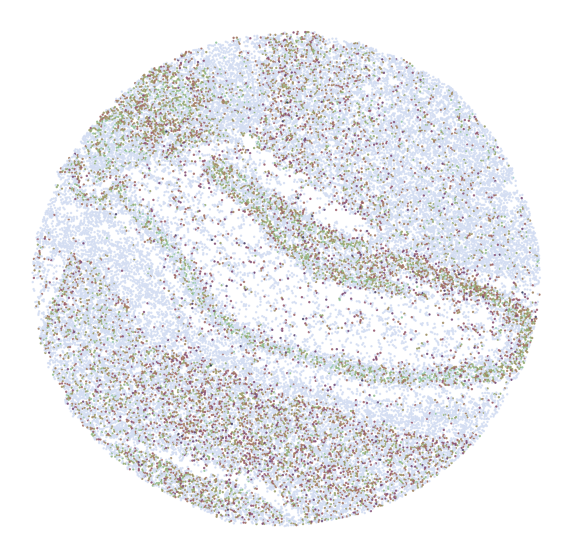

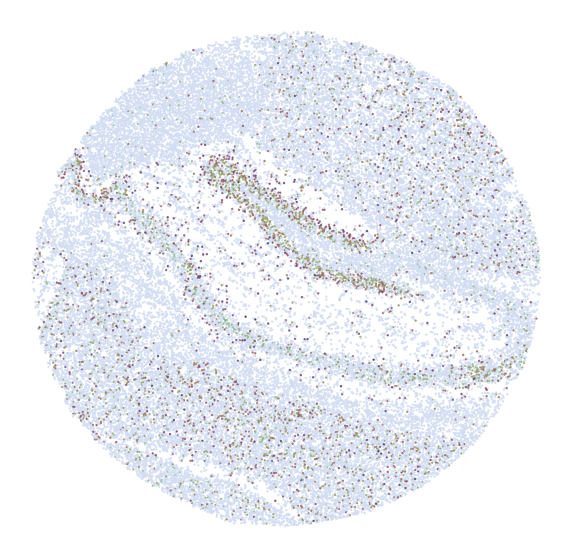

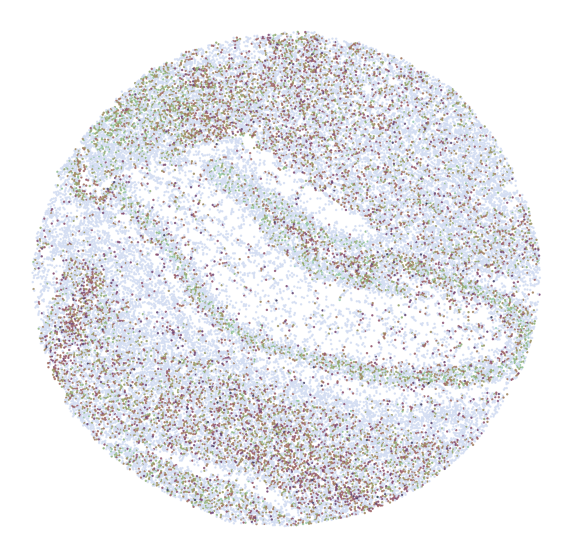

In [15]:
Vis.DrawGenes2(adata_HC1, 'CELF4', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, 'ADCY1', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, 'NRSN1', FM = False, root = root, save = 'HC1')

In [24]:
SVA_HC1[SVA_HC1['LLR'] < 1000].sort_values('imp_sumup_norm', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
6709,GFAP,0.618969,0.103825,741.431409,0.056126
6507,FXYD6,0.539062,0.101278,864.135049,0.088829
12949,NRSN1,0.506774,0.078378,925.400808,0.305016
5884,FAM107A,0.476271,0.048118,170.018228,0.189425
10809,KIF5C,0.472260,0.049286,663.339864,0.258876


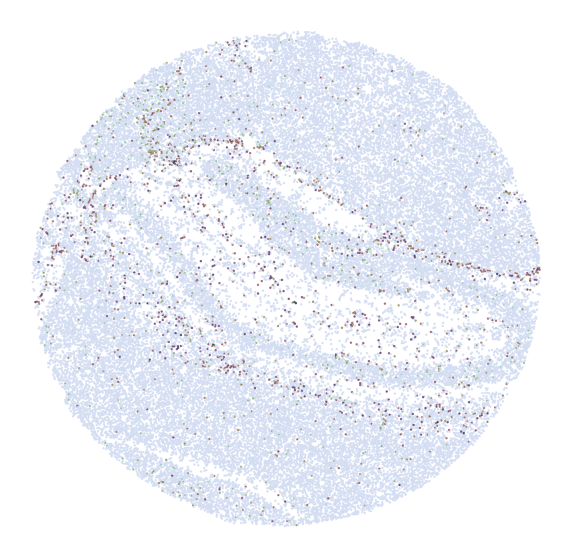

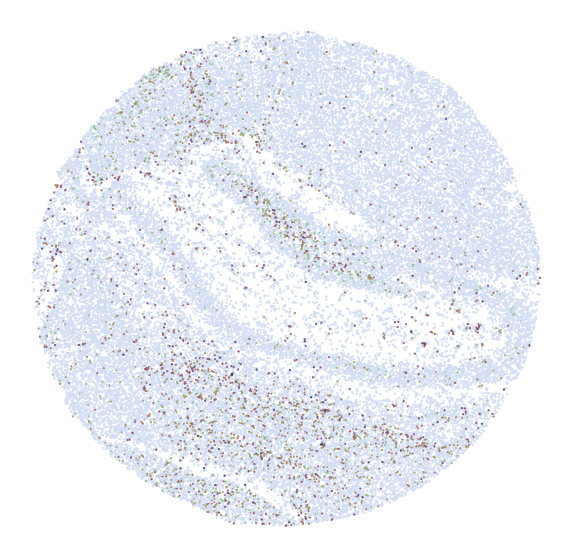

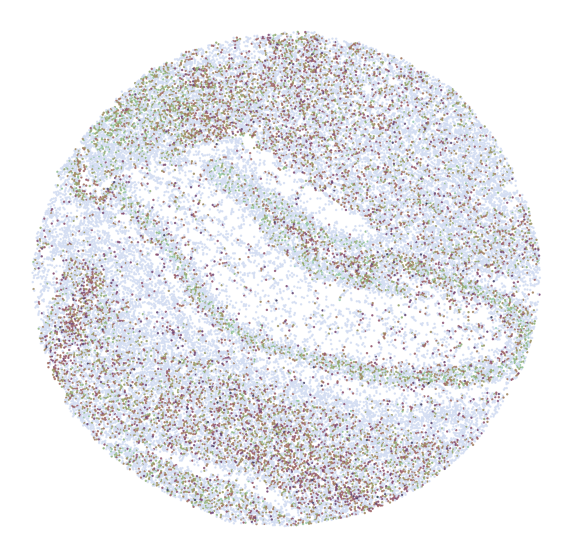

In [25]:
Vis.DrawGenes2(adata_HC1, 'GFAP', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, 'FXYD6', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, 'NRSN1', FM = False, root = root, save = 'HC1')

In [70]:
SVA_HC1.sort_values('LLR', ascending = False).head(10)

,g,imp_sumup_norm,I,LLR,mean_counts,total_counts,n_cells_by_counts_norm
7293,GM13872,0.001785,-0.000059,12139.966742,0.000126,5.0,0.000057
19152,TTR,1.597921,0.386161,10171.369841,4.758839,188983.0,0.343206
8198,GM26724,0.001942,-0.000099,10064.833666,0.000101,4.0,0.000113
65,1500015O10RIK,0.159819,0.489082,9610.082143,0.057841,2297.0,0.026111
10012,HPCA,0.852105,0.436491,9292.032954,1.891897,75131.0,0.417636
12937,NRGN,0.831564,0.429000,7688.491507,1.119334,44451.0,0.377210
17960,TAC2,0.398074,0.382144,6540.679064,0.075091,2982.0,0.040425
310,2010005H15RIK,0.001762,-0.000055,6529.248468,0.000101,4.0,0.000057
9160,GM5741,0.254377,0.321397,6115.001289,0.054593,2168.0,0.034909
3311,CCDC153,0.392114,0.420824,5986.846007,0.048575,1929.0,0.023480


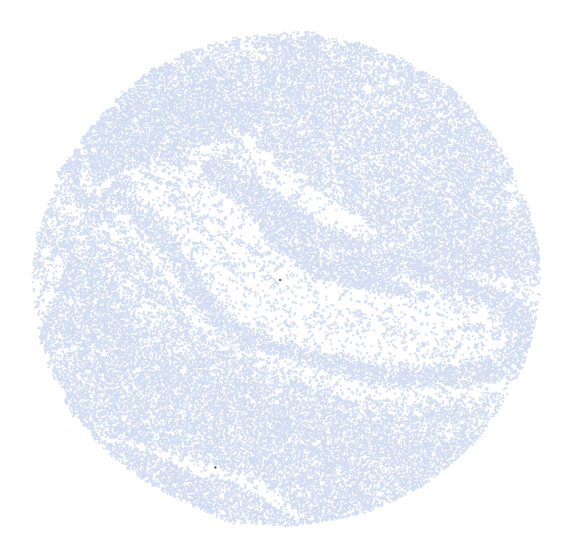

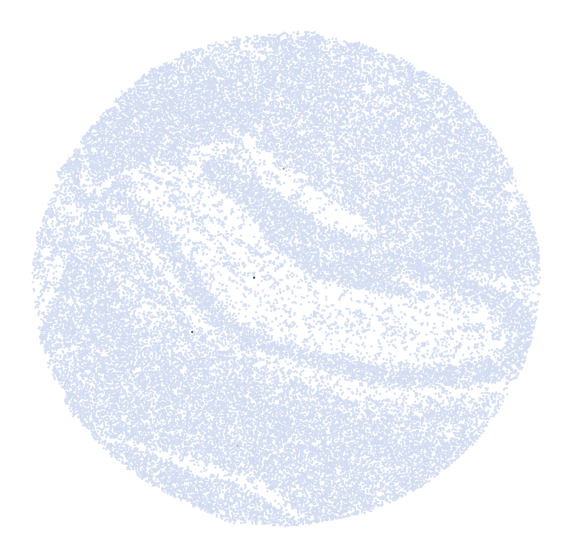

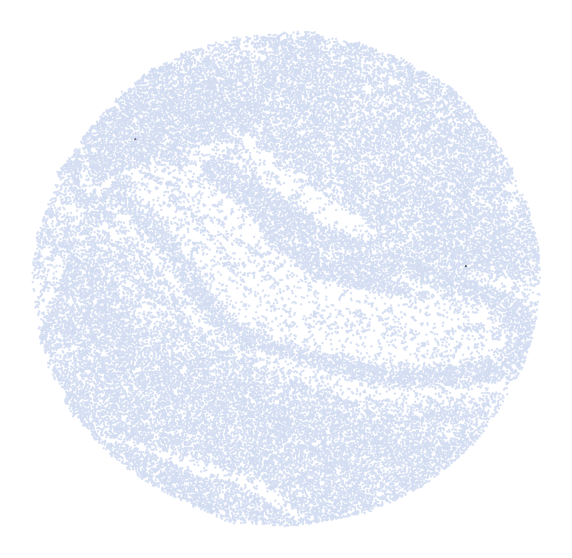

In [71]:
Vis.DrawGenes2(adata_HC1, 'GM13872', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, 'GM26724', FM = False, root = root, save = 'HC1')
Vis.DrawGenes2(adata_HC1, '2010005H15RIK', FM = False, root = root, save = 'HC1')

In [72]:
SVA_HC1.sort_values('imp_sumup_norm', ascending = False).head(10)

,g,imp_sumup_norm,I,LLR,mean_counts,total_counts,n_cells_by_counts_norm
19152,TTR,1.597921,0.386161,10171.369841,4.758839,188983.0,0.343206
13517,PCP4,1.006922,0.368434,5480.306670,1.950670,77465.0,0.559450
19036,TSHZ2,0.984020,0.173547,2158.000881,0.105535,4191.0,0.069252
3101,CALB2,0.953676,0.303996,4676.630485,0.193392,7680.0,0.107952
4817,DDN,0.917070,0.299360,4575.789540,0.537268,21336.0,0.254746
17660,SST,0.895201,0.338623,3521.290359,0.229452,9112.0,0.078446
10012,HPCA,0.852105,0.436491,9292.032954,1.891897,75131.0,0.417636
12937,NRGN,0.831564,0.429000,7688.491507,1.119334,44451.0,0.377210
12798,NNAT,0.789241,0.267478,4396.550423,0.243478,9669.0,0.139410
6613,GAP43,0.758694,0.140086,1608.172726,0.553863,21995.0,0.319698


TTR


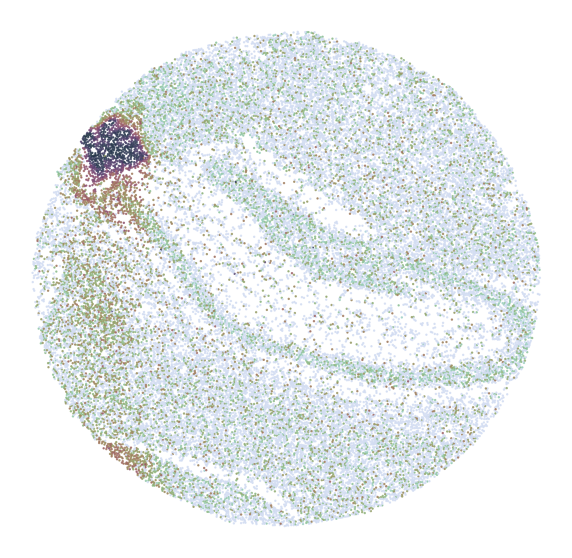

PCP4


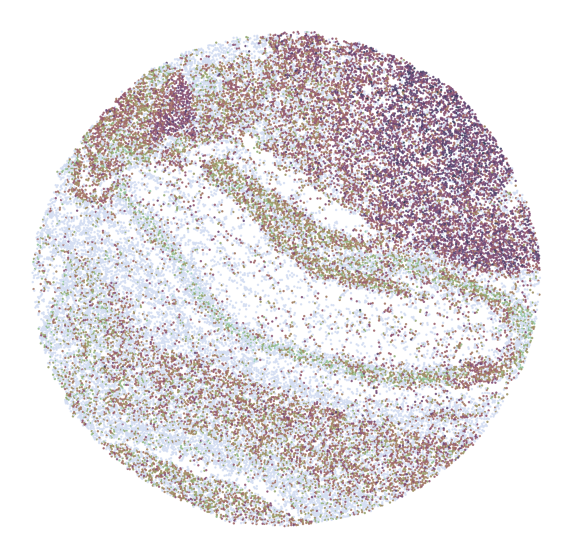

TSHZ2


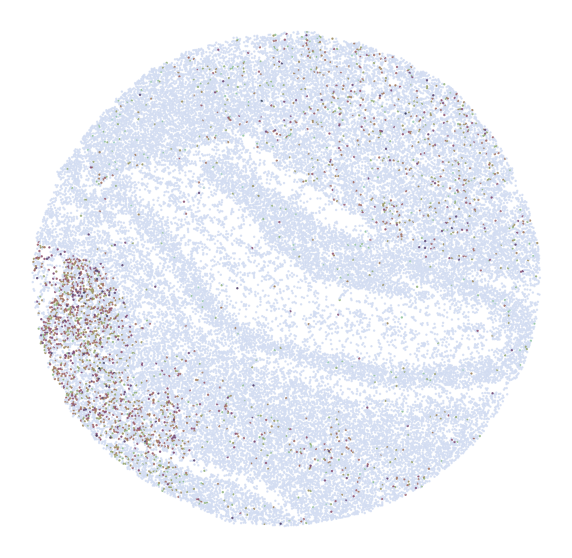

CALB2


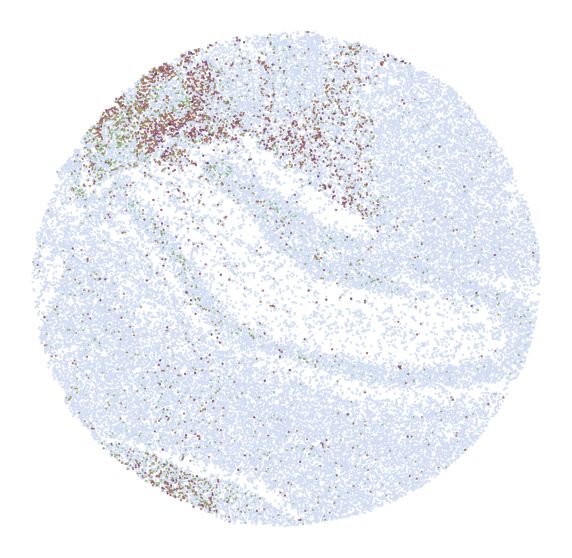

DDN


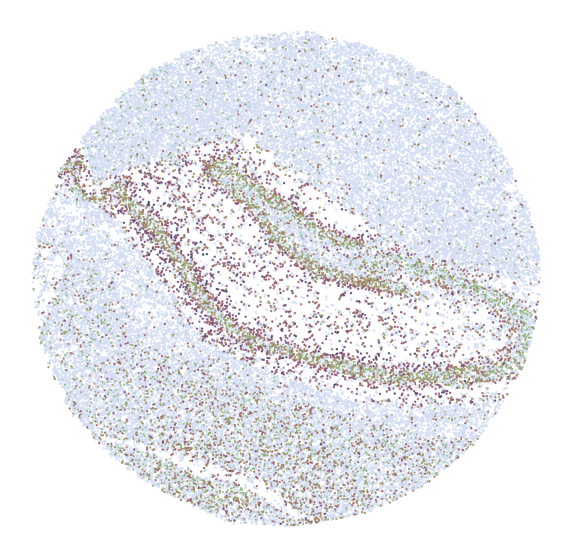

In [73]:
for g in SVA_HC1.sort_values('imp_sumup_norm', ascending = False)['g'][:5]:
    print(g)
    Vis.DrawGenes2(adata_HC1, g, FM = False, root = 'Compare/', save = 'HC1')

# HC2

In [16]:
root = 'Compare/HC2/'
if not os.path.exists(root):
    os.makedirs(root)
    
s = 6

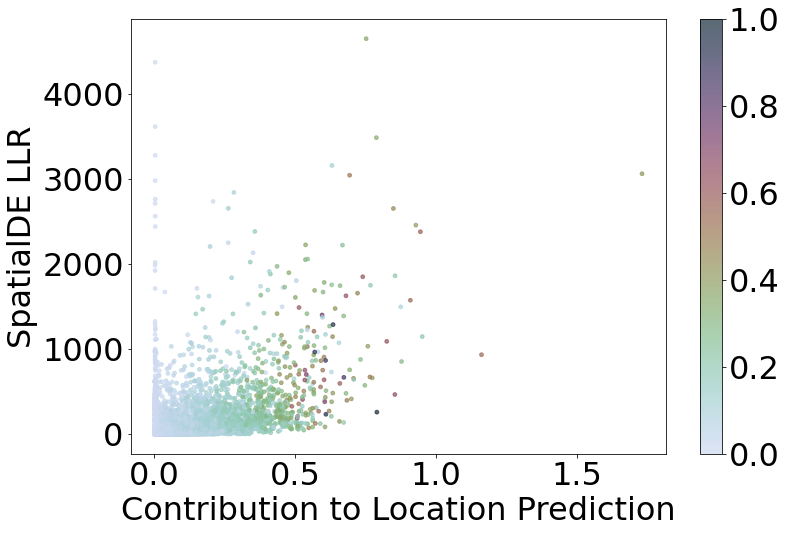

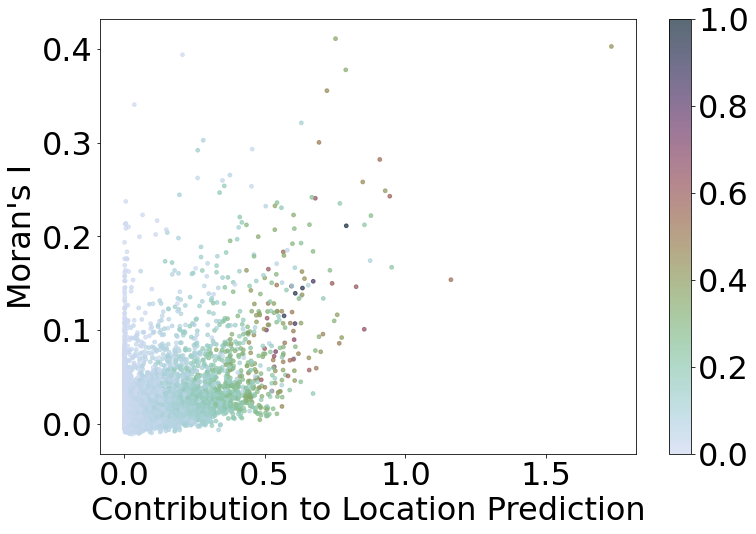

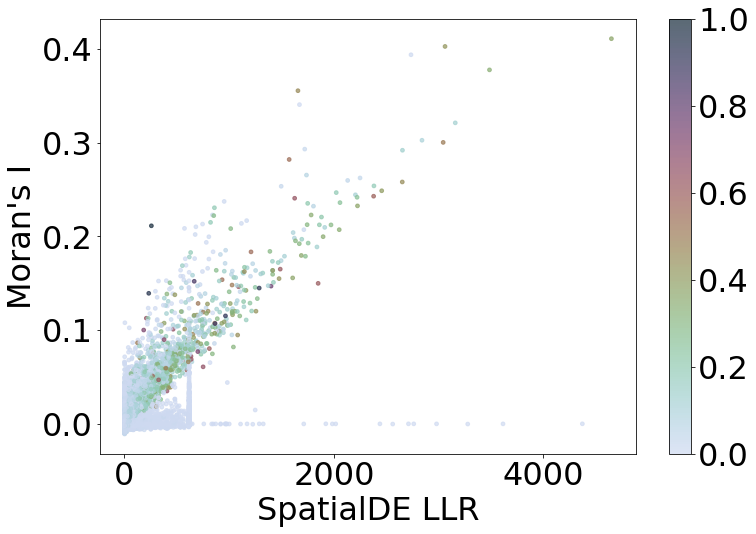

In [17]:
VizCus(SVA_HC2, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'LLR', y_label = 'SpatialDE LLR', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'HC2_imp_LLR_ncell.png')
VizCus(SVA_HC2, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'I', y_label = 'Moran\'s I', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'HC2_imp_I_ncell.png')
VizCus(SVA_HC2, x_name = 'LLR', x_label = 'SpatialDE LLR',
       y_name = 'I', y_label = 'Moran\'s I', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'HC2_LLR_I_ncell.png')

In [39]:
SVA_HC2[SVA_HC2['imp_sumup_norm'] < 0.1].sort_values('I', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
17308,TMEM212,0.037091,0.340443,1670.887075,0.003420
1295,ACTA2,0.006834,0.237185,952.266509,0.005497
10921,MGP,0.066495,0.222752,839.952250,0.009528
4899,DSP,0.007348,0.213731,1116.524158,0.011299
8547,GNRH1,0.004861,0.213023,745.779479,0.001160


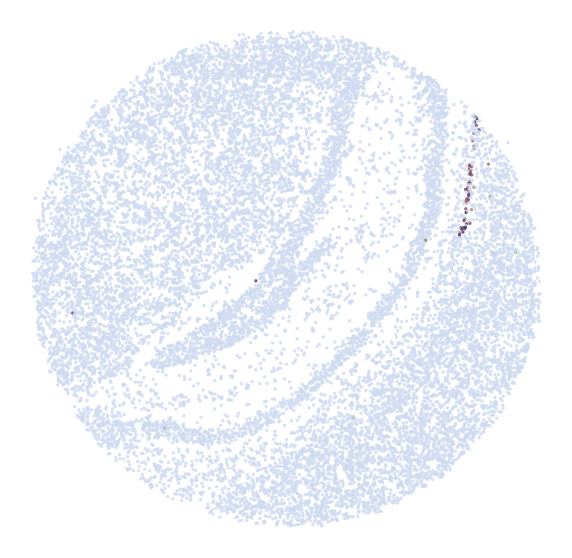

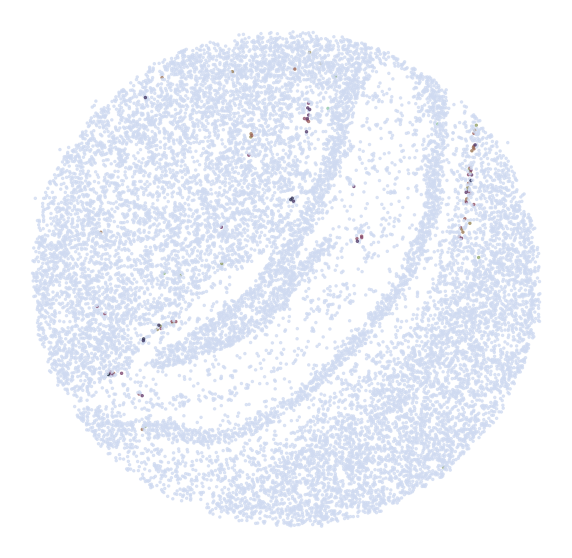

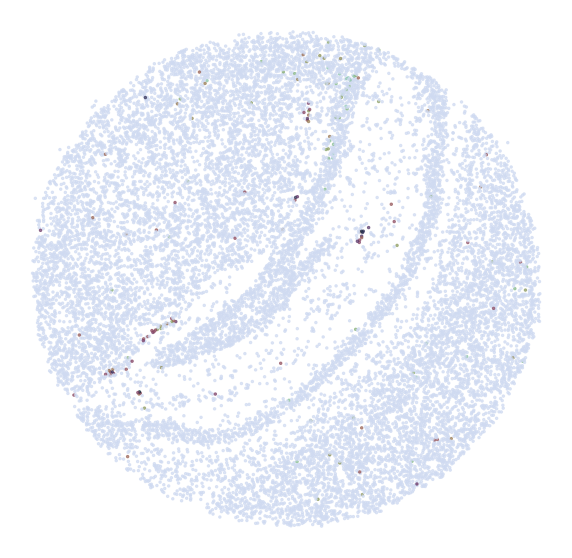

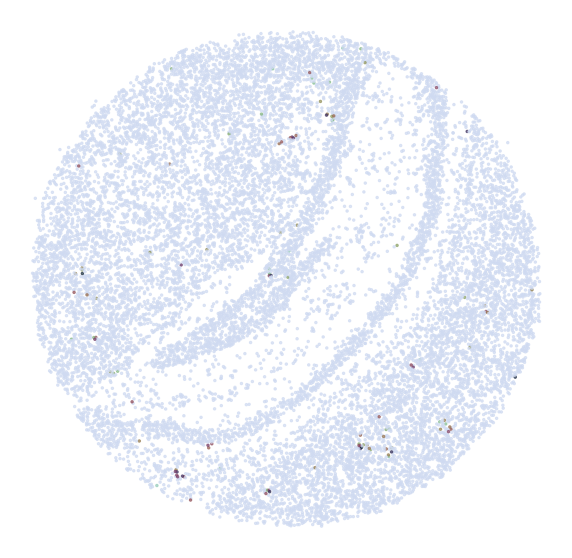

In [16]:
Vis.DrawGenes2(adata_HC2, 'TMEM212', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'ACTA2', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'MGP', s = s, FM = False, root = root, save = 'HC2')

In [17]:
SVA_HC2[SVA_HC2['I'] < 0.1].sort_values('imp_sumup_norm', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
9004,HEXB,0.773511,0.091951,660.070919,0.396384
10110,LARS2,0.764953,0.085817,671.038272,0.499542
2887,CAMK1D,0.707089,0.095623,654.575606,0.477188
2993,CATSPERD,0.699143,0.076787,413.223512,0.411409
9916,KIF5C,0.693111,0.092829,754.860853,0.337446


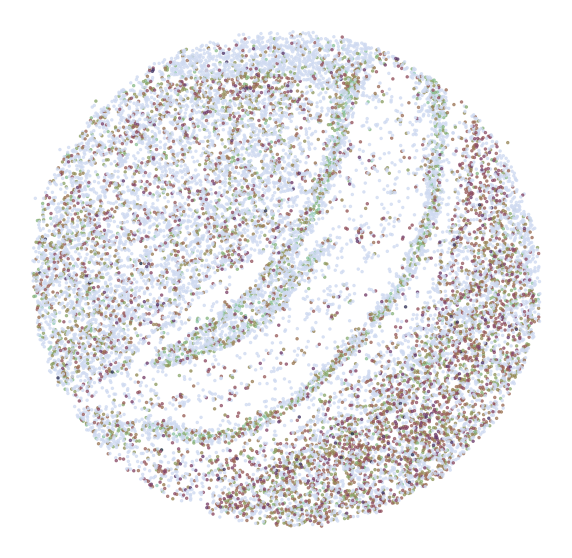

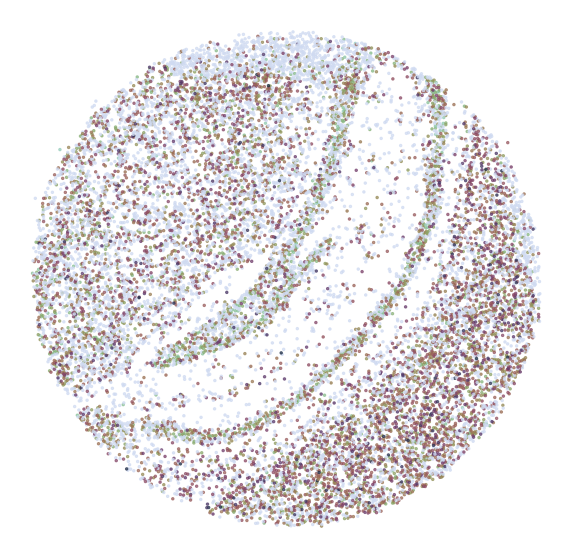

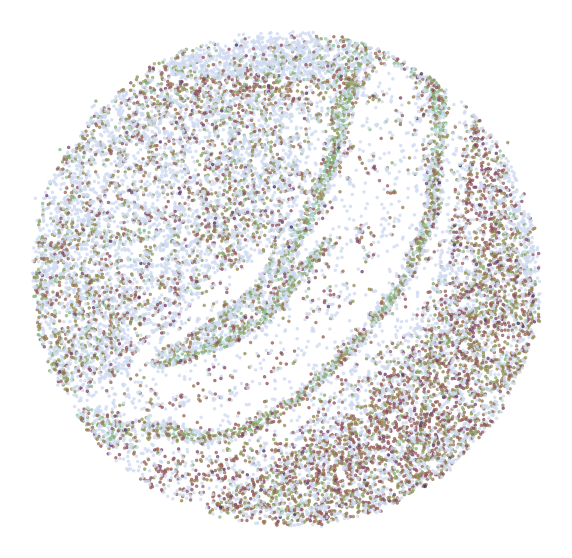

In [18]:
Vis.DrawGenes2(adata_HC2, 'HEXB', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'LARS2', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'CAMK1D', s = s, FM = False, root = root, save = 'HC2')
#Vis.DrawGenes2(adata_HC2, 'CATSPERD', s = s, FM = False, root = root, save = 'HC2')

In [27]:
SVA_HC2[SVA_HC2['LLR'] < 1000].sort_values('imp_sumup_norm', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
9914,KIF5A,1.161397,0.153653,932.821877,0.542295
13564,PTGDS,0.877441,0.222025,852.530995,0.281011
10554,MALAT1,0.853744,0.100813,464.655479,0.647774
19212,MT-RNR2,0.789838,0.211186,257.258154,0.989922
9004,HEXB,0.773511,0.091951,660.070919,0.396384


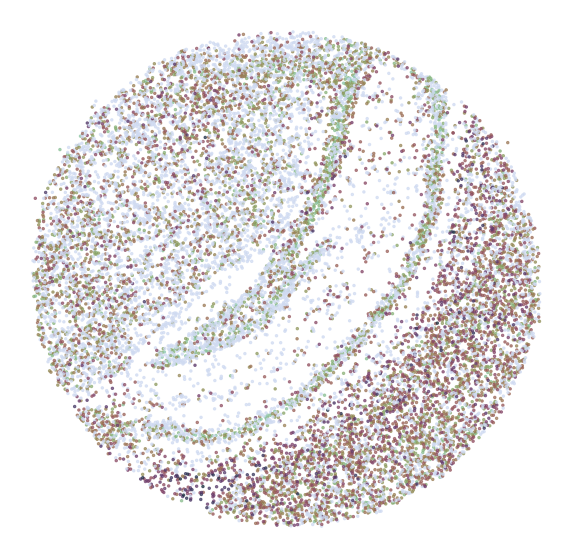

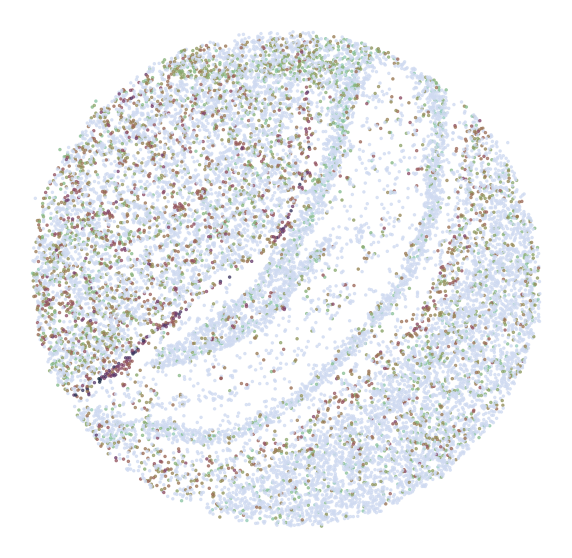

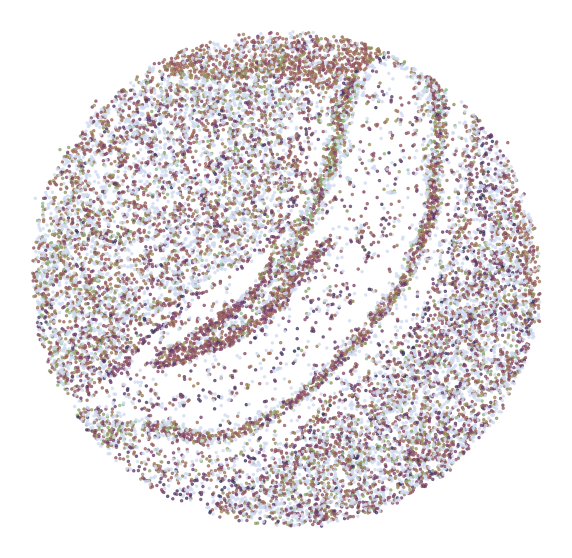

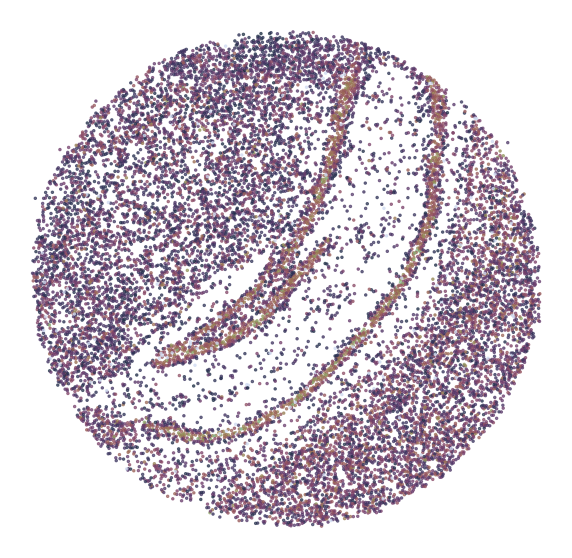

In [36]:
Vis.DrawGenes2(adata_HC2, 'KIF5A', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'PTGDS', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'MALAT1', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'MT-RNR2', s = s, FM = False, root = root, save = 'HC2')

In [29]:
SVA_HC2.sort_values('LLR', ascending = False).head(10)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
9152,HPCA,0.751743,0.410794,4648.343576,0.370305
16974,TERT,0.002164,-0.000059,4371.016038,0.000061
7267,GM19684,0.002327,-0.000116,3613.740856,0.000122
11966,NRGN,0.788018,0.377541,3484.678805,0.343737
6486,GM10640,0.002368,-0.000315,3276.969458,0.000305
4104,CRYM,0.630279,0.321021,3158.017672,0.128443
12518,PCP4,1.731488,0.402518,3060.304090,0.426495
13284,PPP3CA,0.693033,0.300154,3042.712786,0.503878
6665,GM12511,0.002367,-0.000121,2979.349485,0.000122
11695,NEUROD6,0.281960,0.302439,2840.348904,0.103280


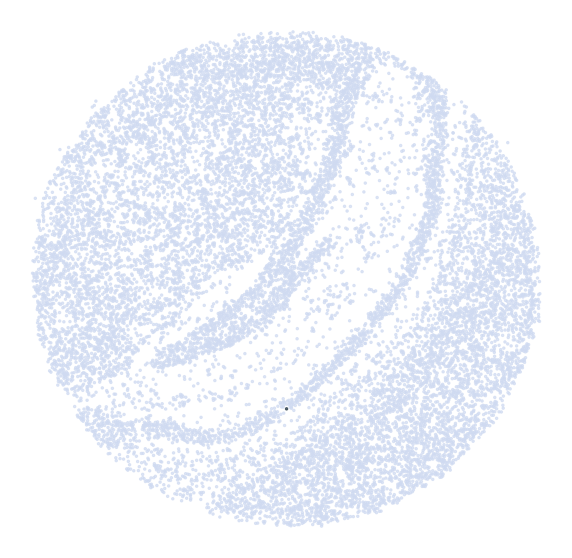

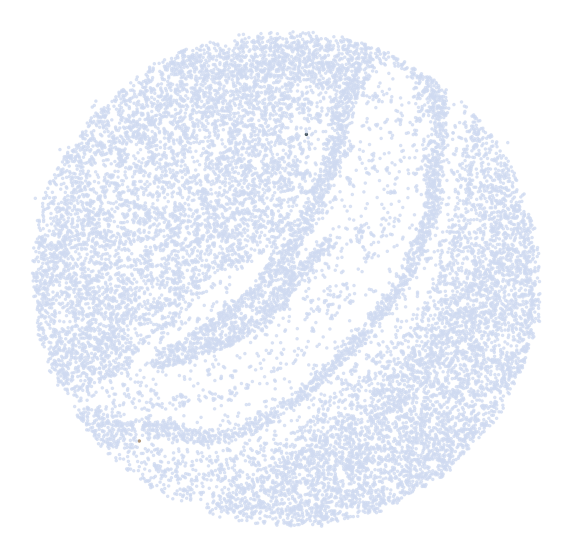

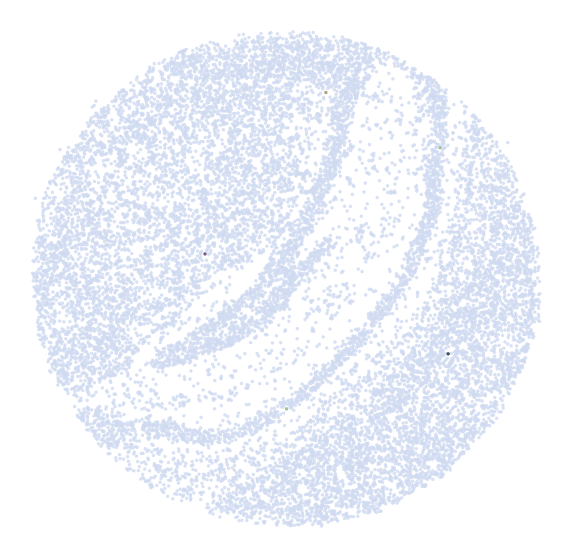

In [30]:
Vis.DrawGenes2(adata_HC2, 'TERT', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'GM19684', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'GM10640', s = s, FM = False, root = root, save = 'HC2')

In [54]:
SVA_HC2.sort_values('imp_sumup_norm', ascending = False).head(5)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
12518,PCP4,1.731488,0.402518,3060.304090,0.426495
9914,KIF5A,1.161397,0.153653,932.821877,0.542295
16276,SPARC,0.950971,0.166919,1145.762413,0.219019
2893,CAMK2N1,0.944362,0.242732,2378.630873,0.588408
2889,CAMK2A,0.928243,0.248568,2455.861468,0.402675


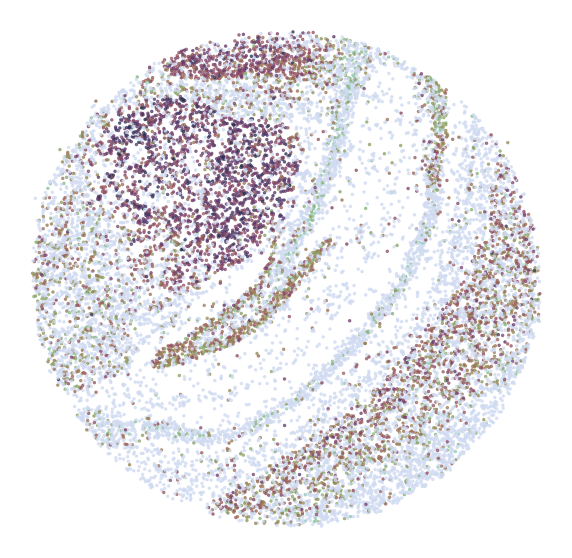

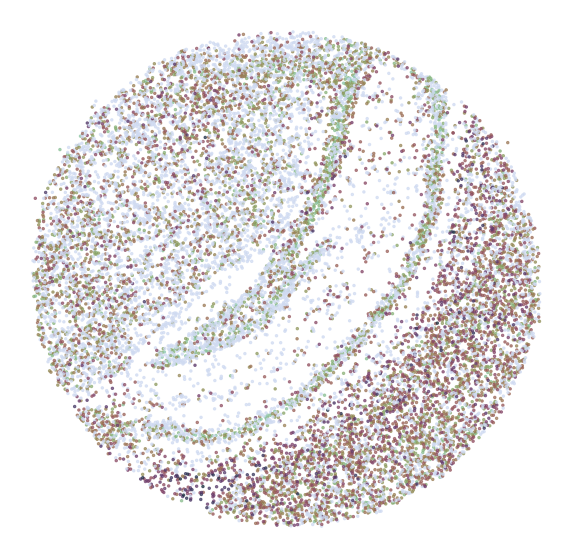

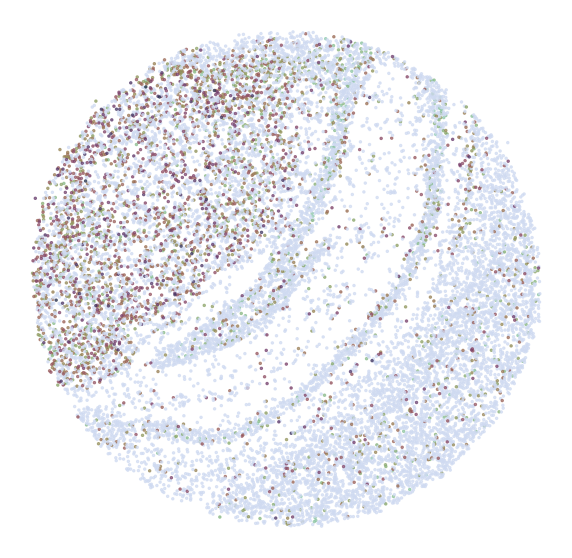

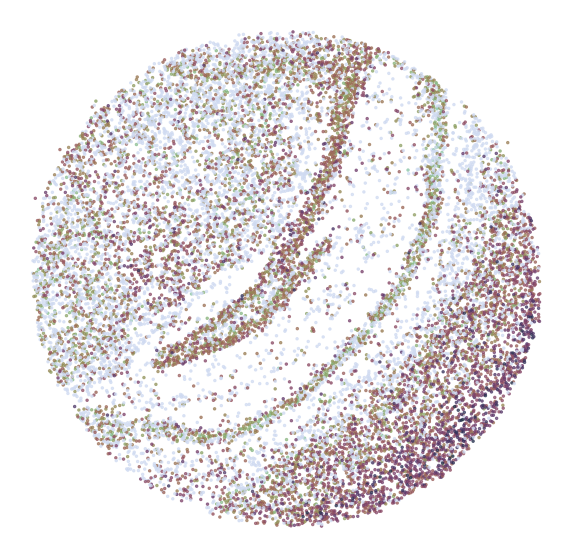

In [32]:
Vis.DrawGenes2(adata_HC2, 'PCP4', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'KIF5A', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'SPARC', s = s, FM = False, root = root, save = 'HC2')
Vis.DrawGenes2(adata_HC2, 'CAMK2N1', s = s, FM = False, root = root, save = 'HC2')

# Em1

In [18]:
root = 'Compare/Em1/'
if not os.path.exists(root):
    os.makedirs(root)
    
s = 2

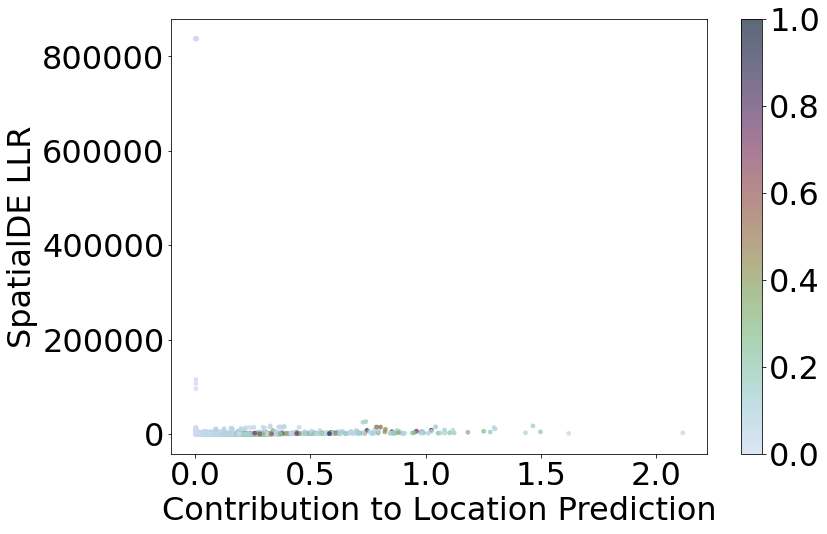

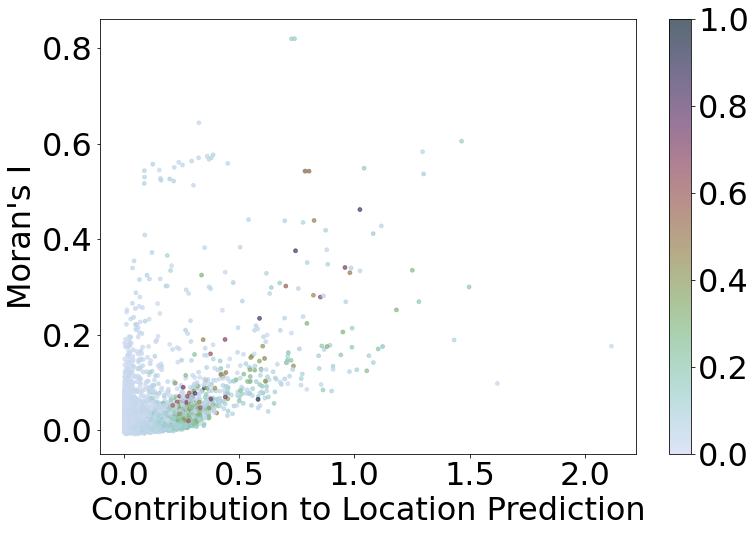

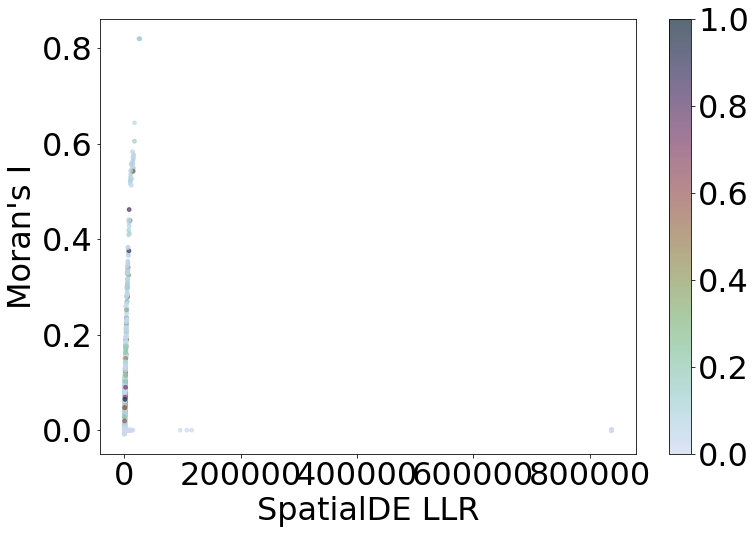

In [21]:
'''
VizCus(SVA_Em1[SVA_Em1['LLR'] > 10000], x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'LLR', y_label = 'SpatialDE LLR', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'Em1_imp_LLR_ncell_p1.png')
VizCus(SVA_Em1[SVA_Em1['LLR'] < 10000], x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'LLR', y_label = 'SpatialDE LLR', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'Em1_imp_LLR_ncell_p2.png')
'''
VizCus(SVA_Em1, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'LLR', y_label = 'SpatialDE LLR', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'Em1_imp_LLR_ncell.png')
VizCus(SVA_Em1, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'I', y_label = 'Moran\'s I', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'Em1_imp_I_ncell.png')
VizCus(SVA_Em1, x_name = 'LLR', x_label = 'SpatialDE LLR',
       y_name = 'I', y_label = 'Moran\'s I', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'Em1_LLR_I_ncell.png')

In [38]:
SVA_Em1[SVA_Em1['imp_sumup_norm'] < 0.1].sort_values('I', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
16226,SERPINA6,0.089089,0.543239,10720.934981,0.077356
1958,APOA1,0.089496,0.529763,10477.848528,0.076994
1960,APOA2,0.088277,0.516540,9926.515673,0.073830
10257,ITIH2,0.090799,0.408537,7065.622583,0.058929
18844,TTR,0.044227,0.354124,5845.739724,0.050910


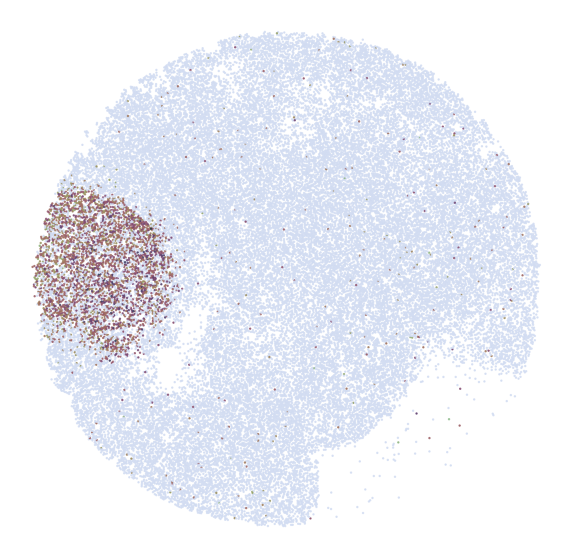

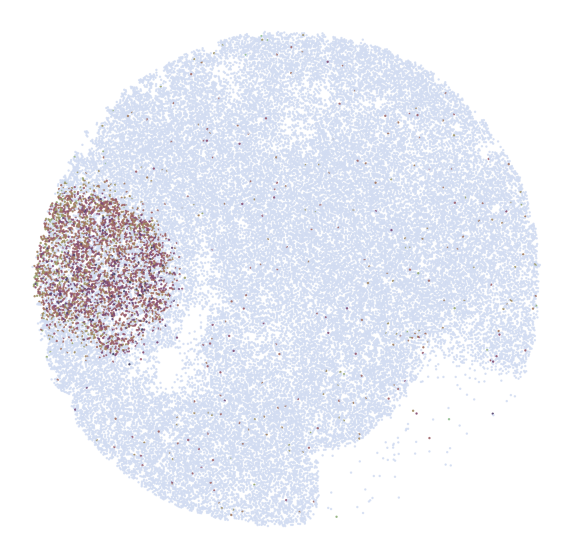

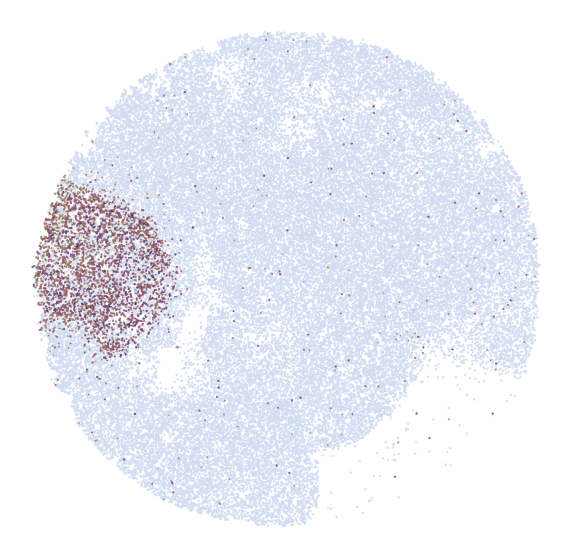

In [44]:
Vis.DrawGenes2(adata_Em1, 'SERPINA6', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'APOA1', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'APOA2', s = s, FM = False, root = root, save = 'Em1')

In [45]:
SVA_Em1[SVA_Em1['I'] < 0.1].sort_values('imp_sumup_norm', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
13608,PITX1,1.620781,0.097699,1246.722034,0.029633
1685,ALCAM,0.901572,0.081709,806.129705,0.091195
12262,NCAM1,0.864094,0.084008,929.991953,0.181520
9703,HOXA9,0.856044,0.095459,1260.294601,0.043230
9717,HOXC10,0.793871,0.085216,865.779875,0.004299


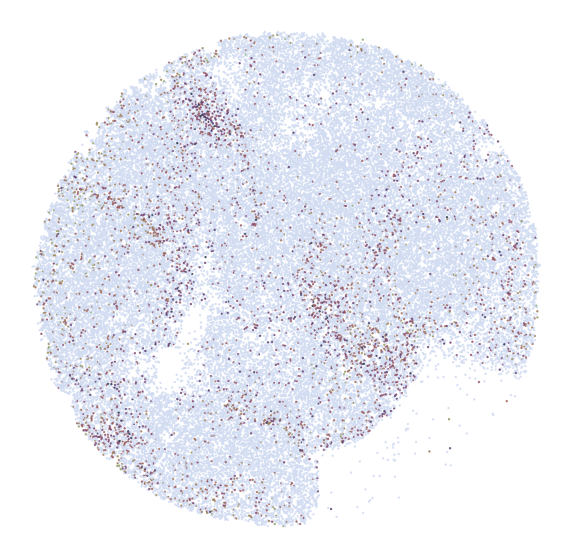

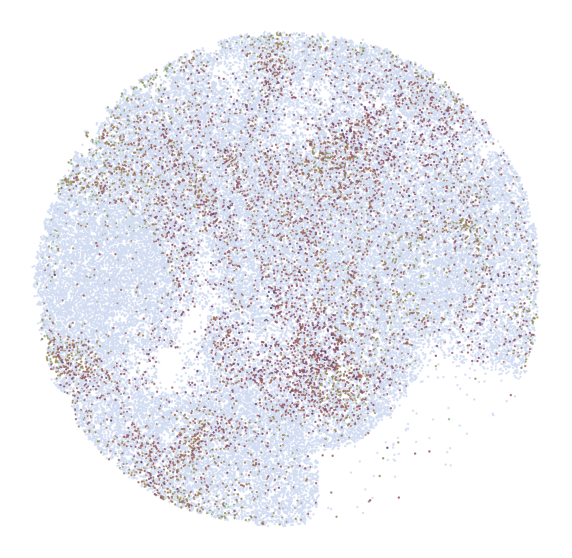

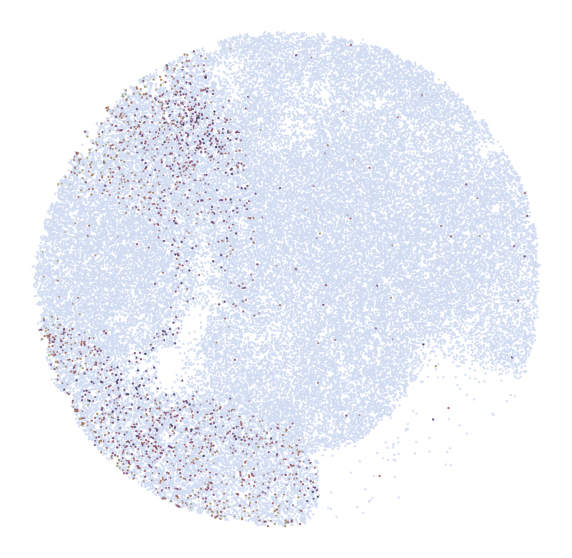

In [38]:
Vis.DrawGenes2(adata_Em1, 'ALCAM', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'NCAM1', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'HOXA9', s = s, FM = False, root = root, save = 'Em1')

In [47]:
SVA_Em1[SVA_Em1['LLR'] < 1000].sort_values('imp_sumup_norm', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
1685,ALCAM,0.901572,0.081709,806.129705,0.091195
12262,NCAM1,0.864094,0.084008,929.991953,0.181520
9717,HOXC10,0.793871,0.085216,865.779875,0.004299
10926,LMX1B,0.711547,0.097348,975.890843,0.012124
6401,FOXP1,0.655306,0.079991,946.296220,0.107569


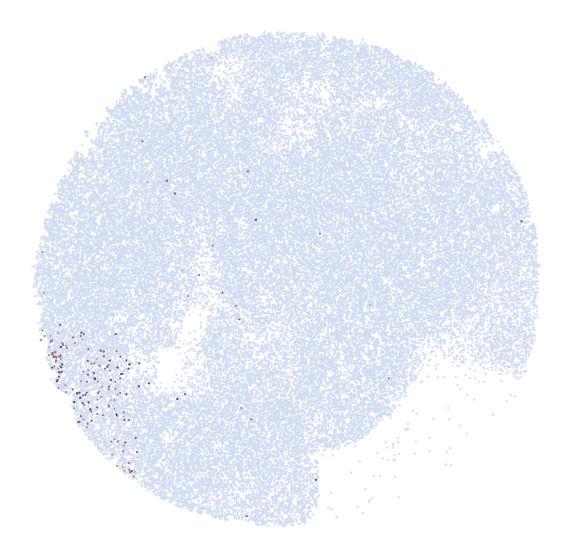

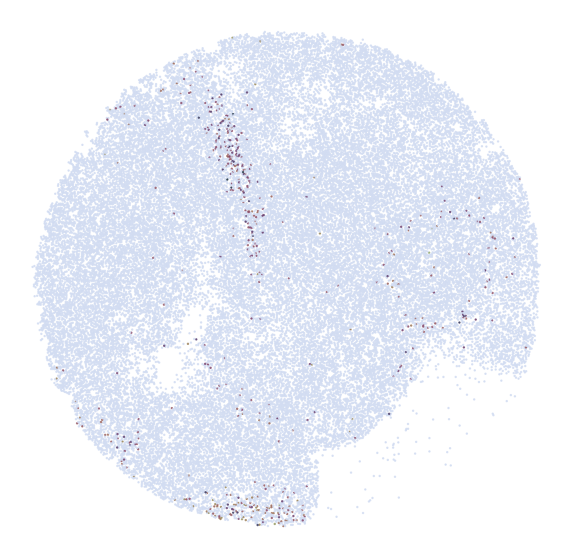

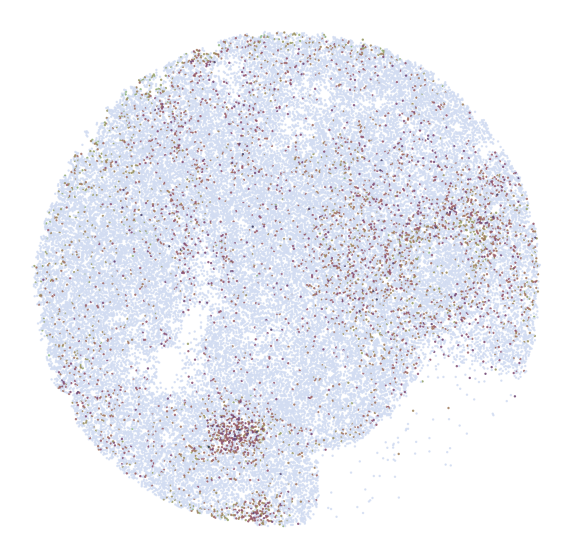

In [48]:
Vis.DrawGenes2(adata_Em1, 'HOXC10', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'LMX1B', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'FOXP1', s = s, FM = False, root = root, save = 'Em1')

In [50]:
SVA_Em1.sort_values('LLR', ascending = False).head(5)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
10686,KRT75,0.002590,-0.000069,837251.144055,0.000072
268,1810012K16RIK,0.002597,-0.000090,837251.144055,0.000097
5182,DTHD1,0.002416,-0.000077,837251.144055,0.000072
7481,GM15963,0.002462,-0.000068,837251.144055,0.000072
14928,RP24-333I1.6,0.002395,-0.000076,837251.144055,0.000072


In [51]:
SVA_Em1[SVA_Em1['LLR'] < 10000].sort_values('LLR', ascending = False).head(5)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
18181,TMEM171,0.002766,-0.000069,9931.766459,0.000072
1960,APOA2,0.088277,0.516540,9926.515673,0.073830
9420,HBA-A1,0.825303,0.438958,9857.799594,0.462662
9405,HAS1,0.002645,-0.000101,9722.399838,0.000097
10845,LHX1OS,0.002449,-0.000077,9226.557026,0.000072


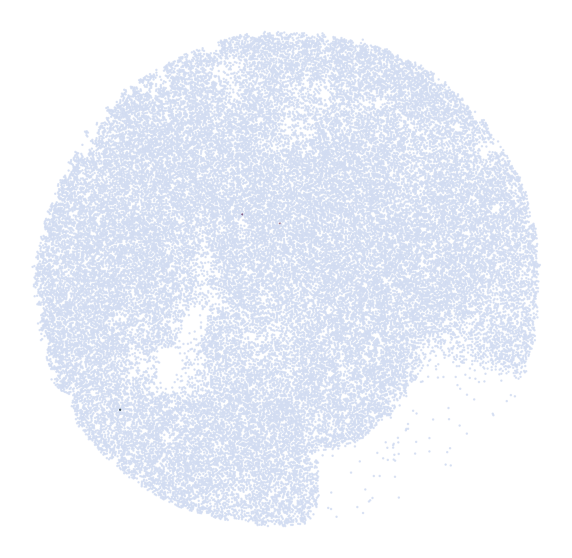

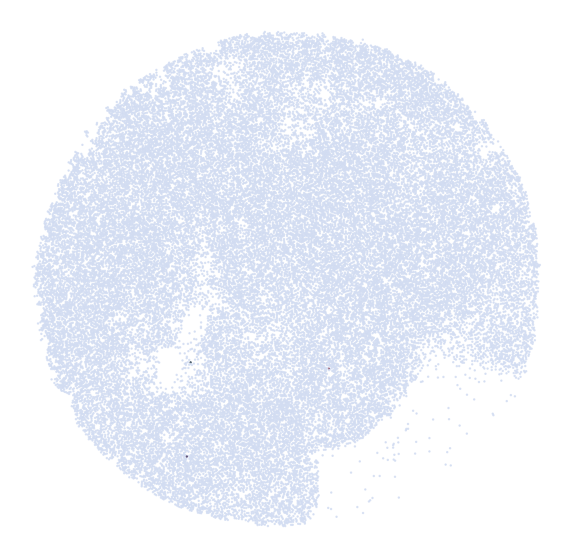

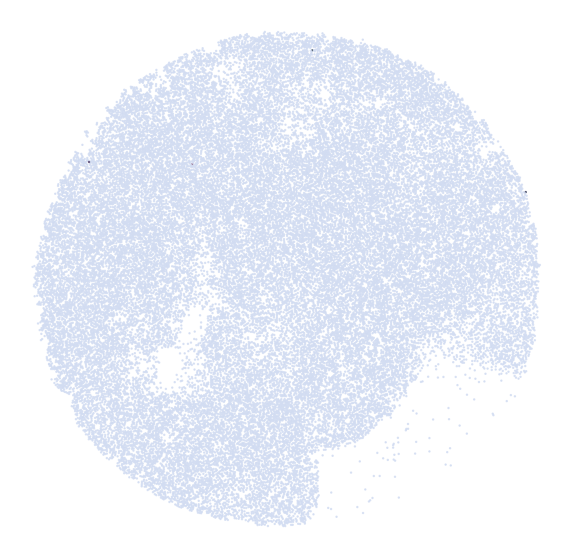

In [53]:
Vis.DrawGenes2(adata_Em1, 'KRT75', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'TMEM171', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'HAS1', s = s, FM = False, root = root, save = 'Em1')

In [55]:
SVA_Em1.sort_values('imp_sumup_norm', ascending = False).head(5)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
17766,TBX5,2.115702,0.175801,2562.478513,0.033329
13608,PITX1,1.620781,0.097699,1246.722034,0.029633
4484,CXCL14,1.498242,0.299798,4596.738326,0.199416
4330,CRYBA1,1.465427,0.604893,17288.374942,0.139207
16396,SHOX2,1.433012,0.188711,2680.706218,0.083901


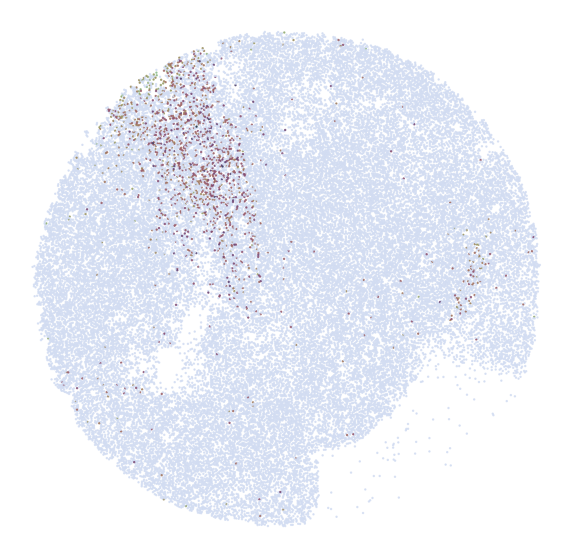

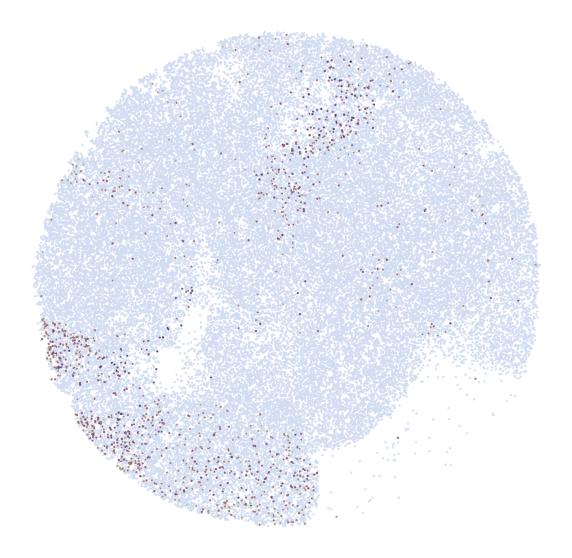

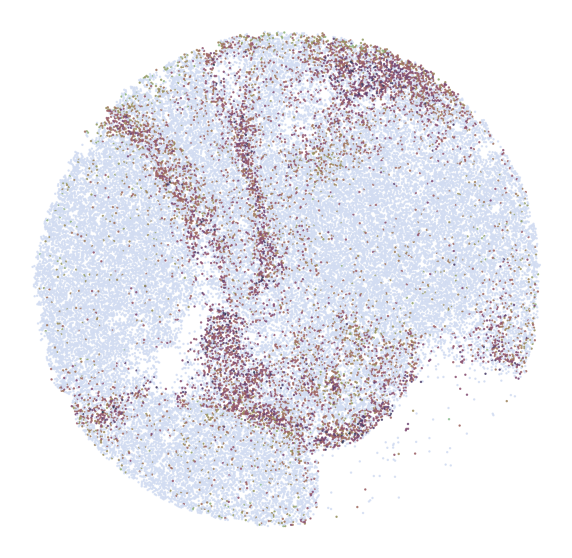

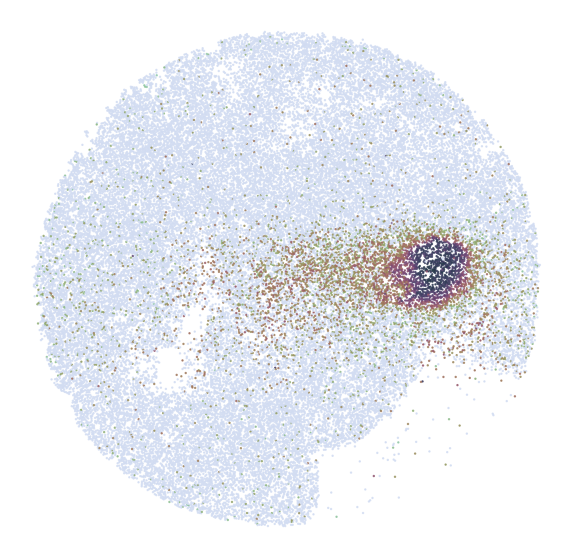

In [56]:
Vis.DrawGenes2(adata_Em1, 'TBX5', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'PITX1', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'CXCL14', s = s, FM = False, root = root, save = 'Em1')
Vis.DrawGenes2(adata_Em1, 'CRYBA1', s = s, FM = False, root = root, save = 'Em1')

# MOB

In [45]:
root = 'Compare/MOB/'
if not os.path.exists(root):
    os.makedirs(root)
    
s = 344

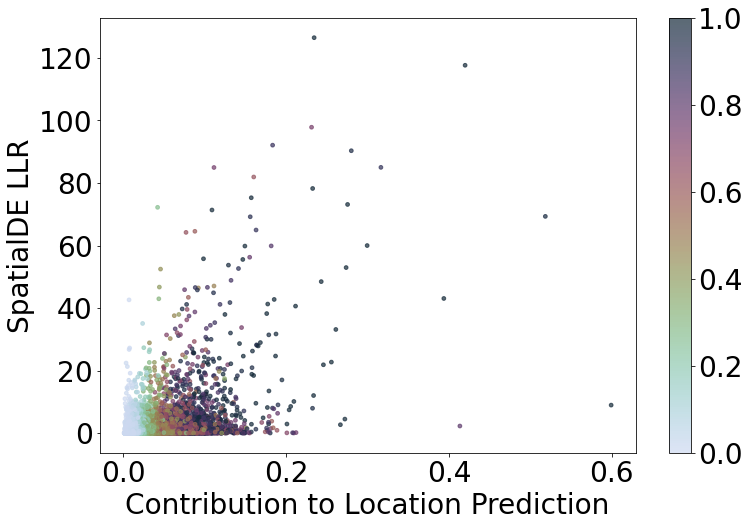

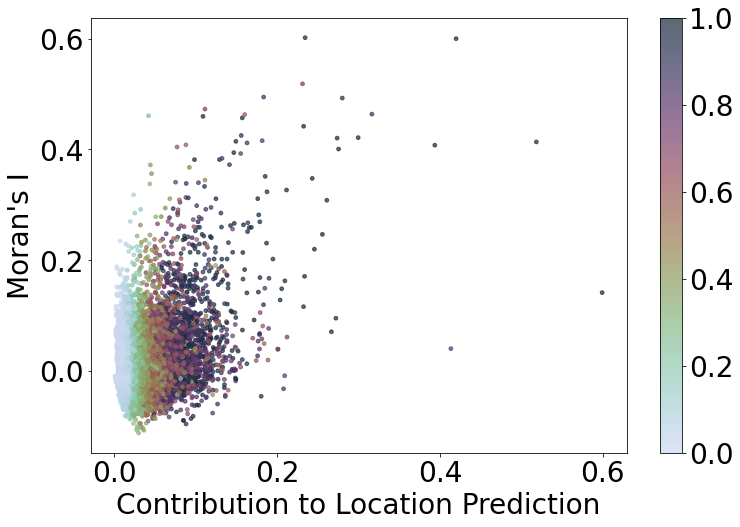

In [8]:
VizCus(SVA_MOB, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'LLR', y_label = 'SpatialDE LLR', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'MOB_imp_LLR_ncell_p2.png')
VizCus(SVA_MOB, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'I', y_label = 'Moran\'s I', root = root, c_name = 'n_cells_by_counts_norm',
       vmin = 0, vmax = 1, save = 'MOB_imp_I_ncell.png')

In [9]:
SVA_MOB[SVA_MOB['imp_sumup_norm'] < 0.1].sort_values('I', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
6628,Igfbp4,0.041984,0.460989,72.218629,0.269784
6580,Atf5,0.087798,0.408341,64.547550,0.597122
2027,Ccnd1,0.076904,0.404542,64.203147,0.629496
1071,Camk2n1,0.098354,0.381705,55.761048,1.000000
743,Hmgcs2,0.044155,0.372201,46.696925,0.399281


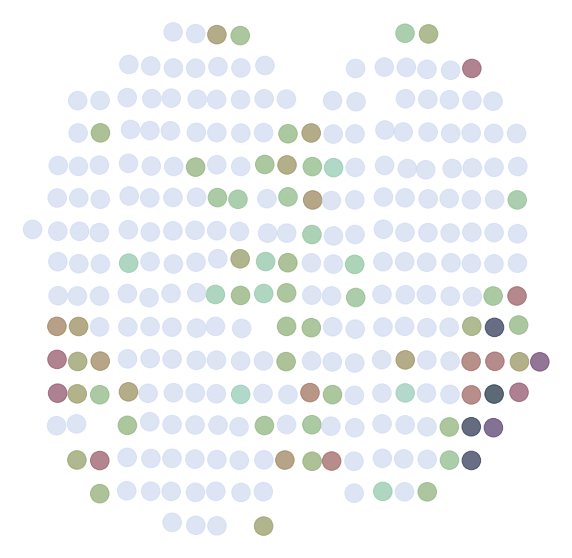

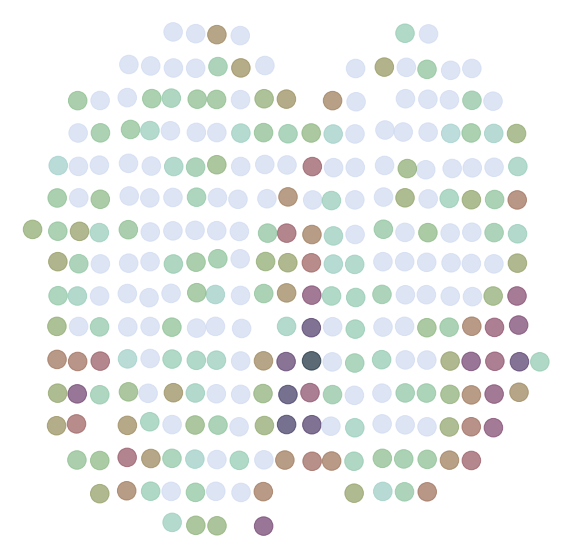

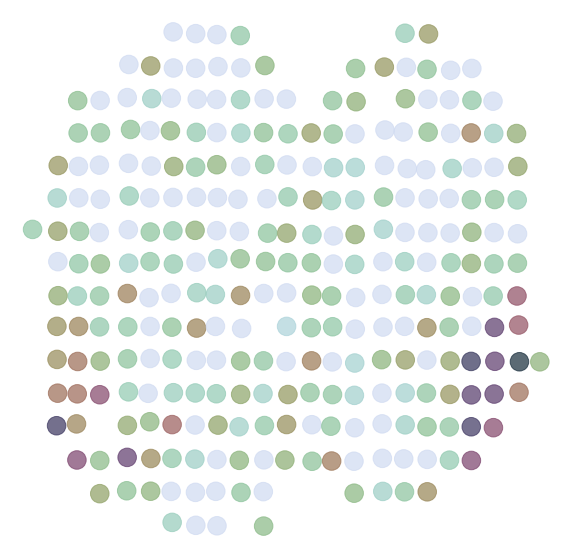

In [13]:
Vis.DrawGenes2(adata_MOB, 'Igfbp4', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Atf5', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Ccnd1', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')

In [14]:
SVA_MOB[SVA_MOB['I'] < 0.1].sort_values('imp_sumup_norm', ascending = False).head()

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
4878,Usp7,0.413313,0.040415,2.245989,0.802158
886,Tuba1a,0.272048,0.095390,4.460319,1.000000
479,Cst3,0.266532,0.070953,2.662535,1.000000
4741,Cep170,0.212069,0.061374,0.144450,0.762590
1835,Atp6v0a1,0.209150,-0.008477,0.000899,0.802158


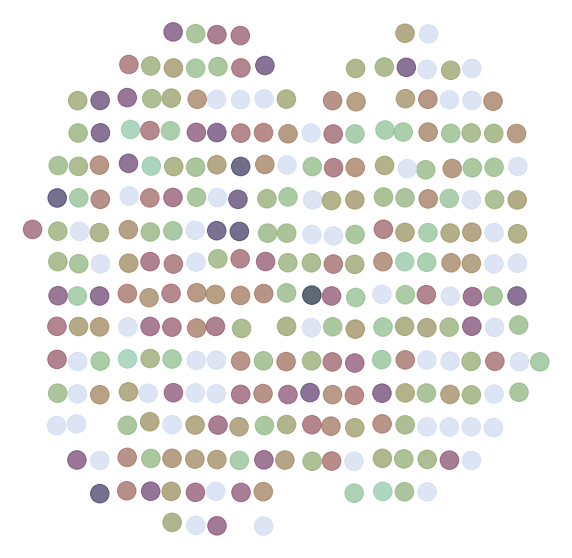

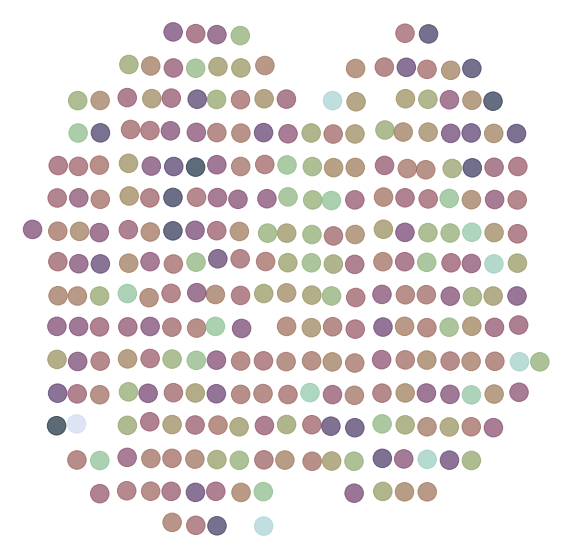

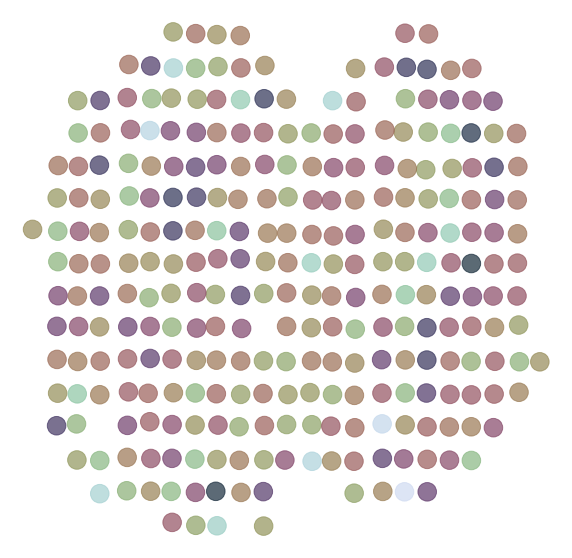

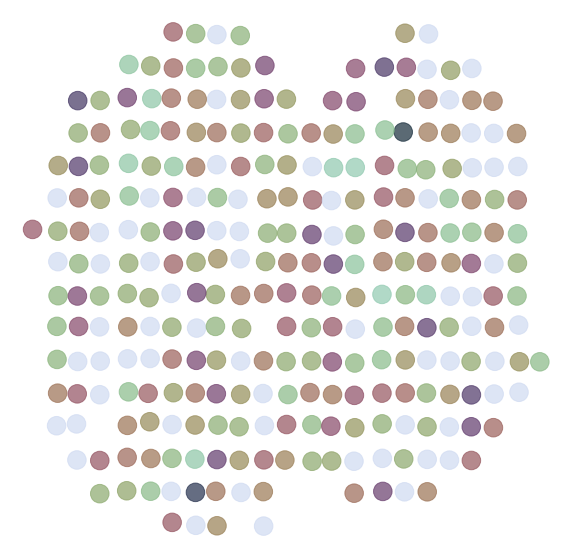

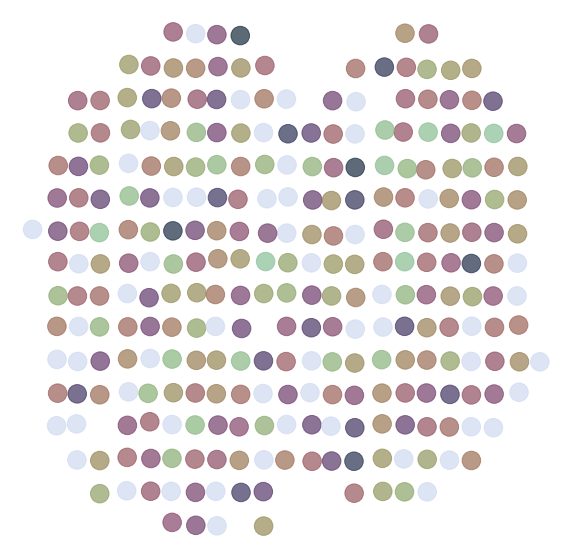

In [46]:
Vis.DrawGenes2(adata_MOB, 'Usp7', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Tuba1a', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Cst3', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Cep170', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Atp6v0a1', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')

In [47]:
SVA_MOB[SVA_MOB['LLR'] < 10].sort_values('imp_sumup_norm', ascending = False).head(10)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
796,Beta-s,0.599138,0.141619,8.933675,1.000000
4878,Usp7,0.413313,0.040415,2.245989,0.802158
886,Tuba1a,0.272048,0.095390,4.460319,1.000000
479,Cst3,0.266532,0.070953,2.662535,1.000000
5588,Calb2,0.232301,0.116175,7.925871,0.960432
4741,Cep170,0.212069,0.061374,0.144450,0.762590
1835,Atp6v0a1,0.209150,-0.008477,0.000899,0.802158
5540,Tmed10,0.207800,-0.032019,0.097913,0.845324
767,Eef1a1,0.205463,0.148597,8.507860,1.000000
4554,Atp5b,0.203580,0.128225,7.410548,1.000000


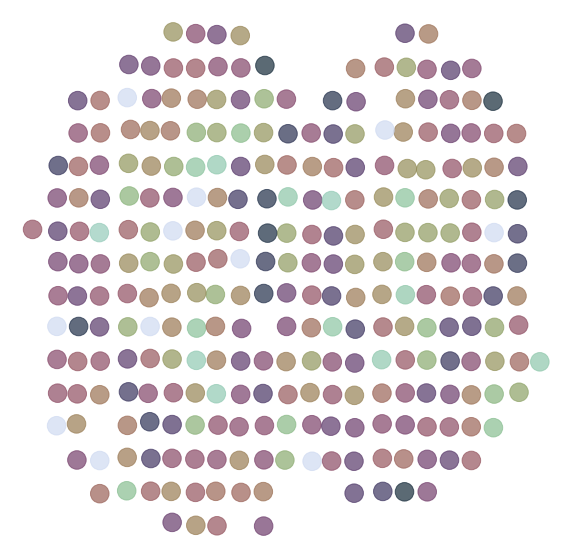

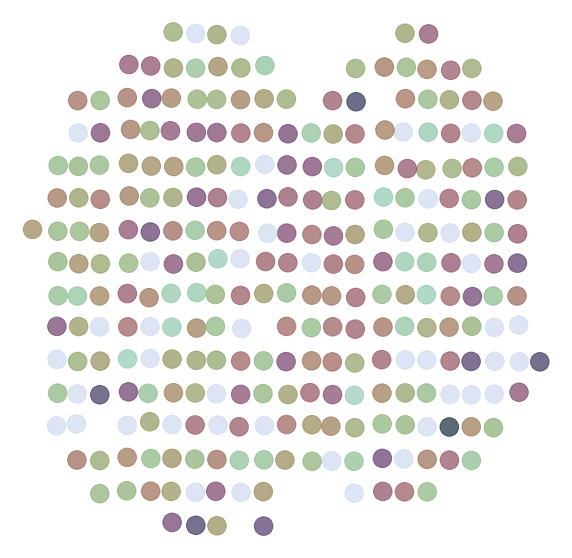

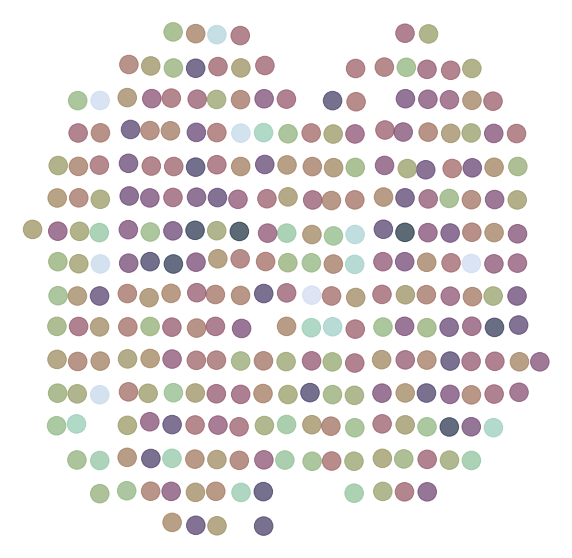

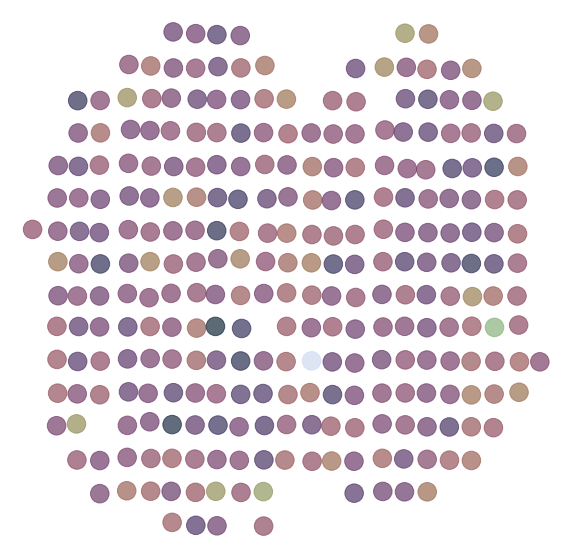

In [48]:
Vis.DrawGenes2(adata_MOB, 'Calb2', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Tmed10', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Eef1a1', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Atp5b', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')

In [25]:
SVA_MOB[SVA_MOB['imp_sumup_norm']<0.05].sort_values('LLR', ascending = False).head(5)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
6628,Igfbp4,0.041984,0.460989,72.218629,0.269784
6710,Hey2,0.045603,0.356420,52.452854,0.435252
743,Hmgcs2,0.044155,0.372201,46.696925,0.399281
8528,Foxd3,0.043479,0.337833,42.954173,0.312950
12902,Cabs1,0.006928,0.234674,42.612335,0.010791


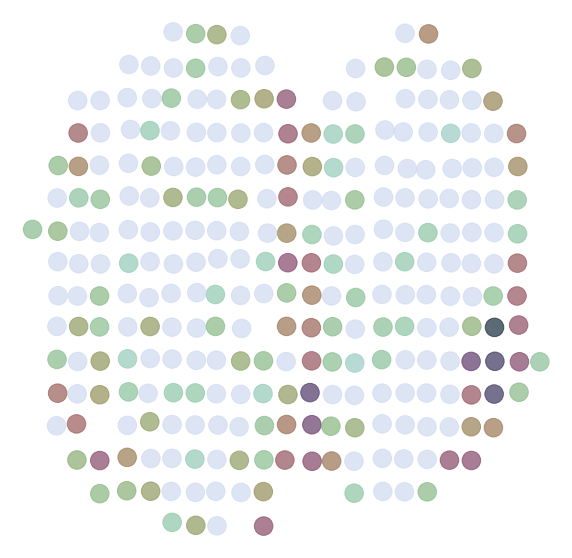

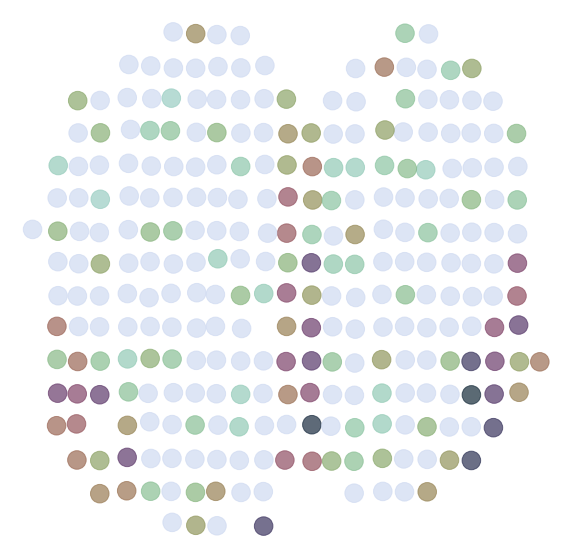

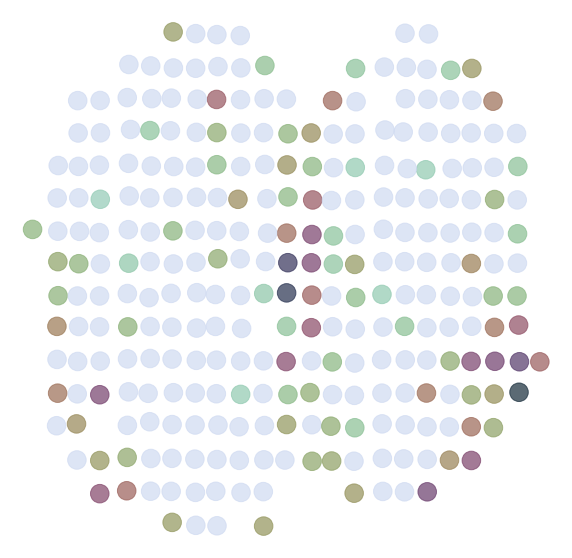

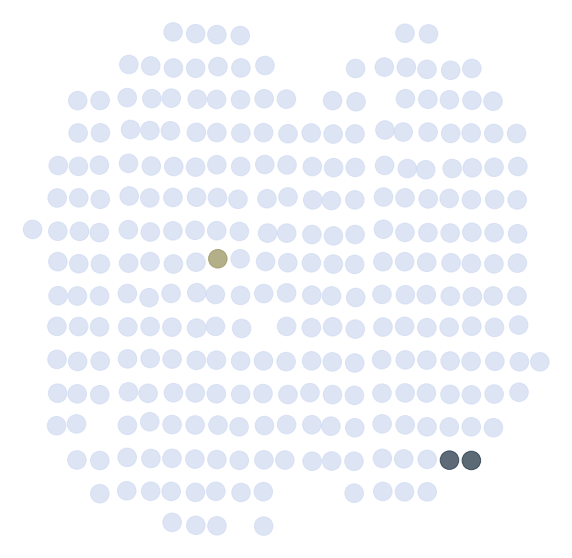

In [49]:
Vis.DrawGenes2(adata_MOB, 'Hey2', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Hmgcs2', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Foxd3', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Cabs1', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')

In [27]:
SVA_MOB.sort_values('imp_sumup_norm', ascending = False).head(5)

,g,imp_sumup_norm,I,LLR,n_cells_by_counts_norm
796,Beta-s,0.599138,0.141619,8.933675,1.000000
590,Kif5b,0.518278,0.413633,69.321333,0.971223
726,Apoe,0.419743,0.600084,117.669333,1.000000
4878,Usp7,0.413313,0.040415,2.245989,0.802158
5104,Cdr1,0.393595,0.407790,43.055310,0.996403


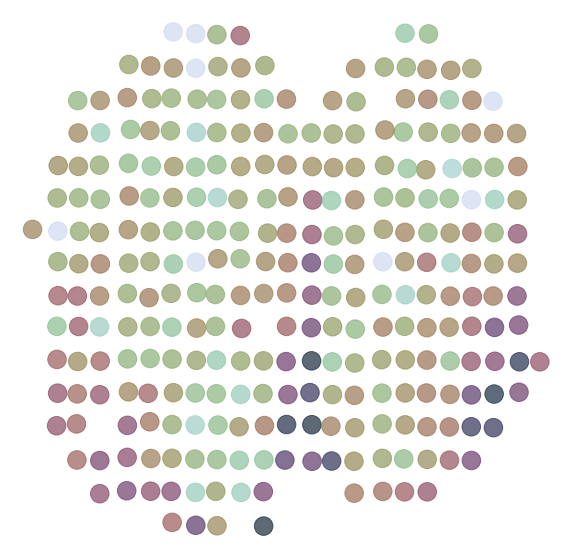

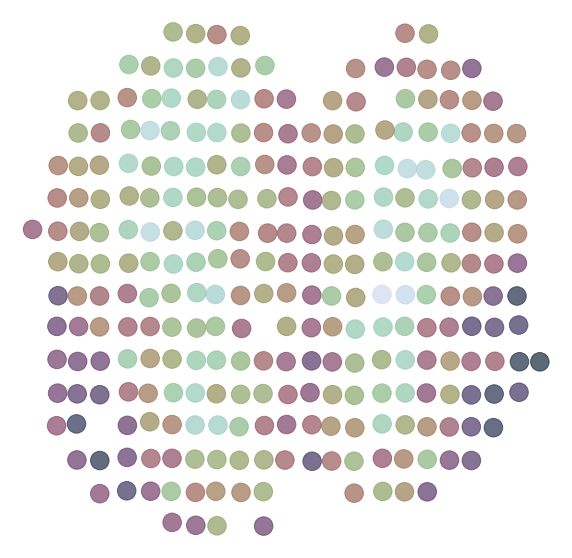

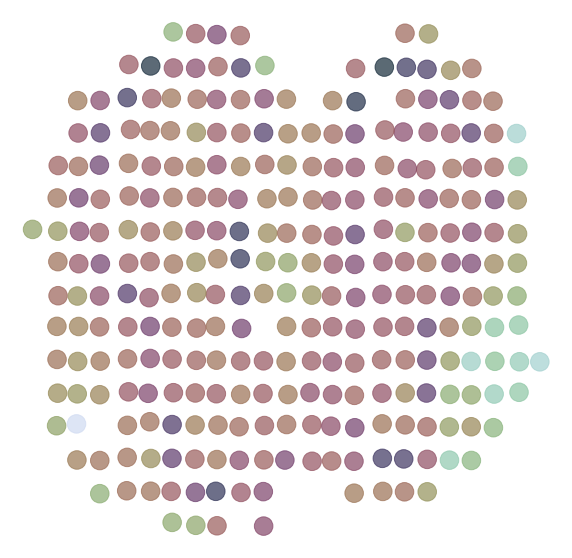

In [28]:
Vis.DrawGenes2(adata_MOB, 'Kif5b', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Apoe', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')
Vis.DrawGenes2(adata_MOB, 'Cdr1', s = s, FM = False, Sparse = False,
               x_name='x', y_name = 'y', root = root, save = 'MOB')